# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [55]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [56]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [57]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [58]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [59]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [60]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat([x.float(), y.float()], 1)
    #### END CODE HERE ####
    return combined

In [61]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [62]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [63]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [64]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = n_classes + mnist_shape[0]
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [65]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [66]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.2126883989572526, discriminator loss: 0.2719074033610523


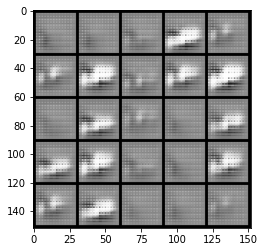

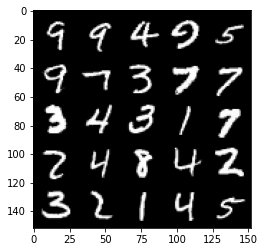

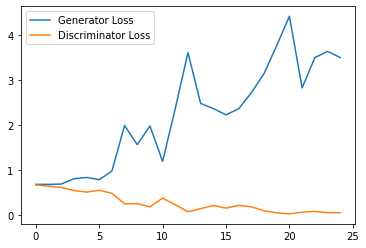

Step 1000: Generator loss: 3.987051257610321, discriminator loss: 0.04662187784910202


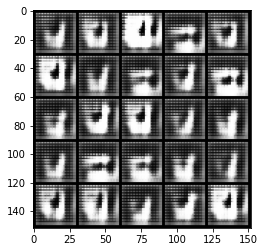

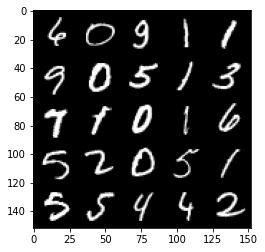

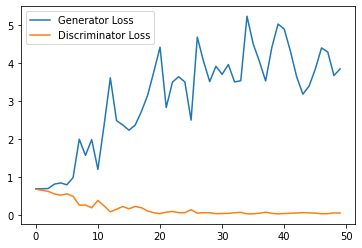

Step 1500: Generator loss: 4.222751375675202, discriminator loss: 0.05591470899060368


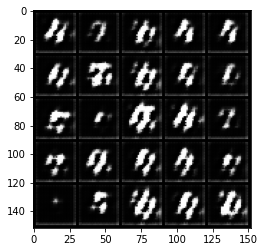

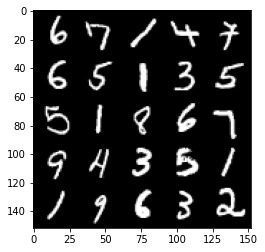

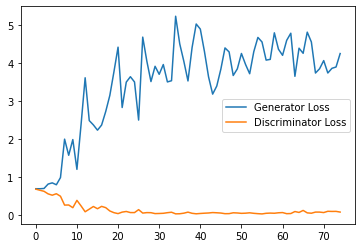

Step 2000: Generator loss: 3.350354804992676, discriminator loss: 0.12911538358032704


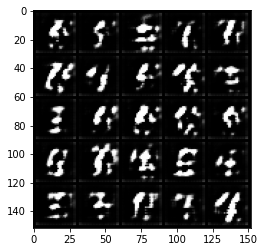

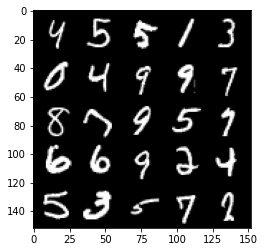

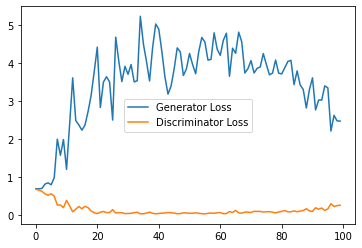

Step 2500: Generator loss: 2.6508036885261537, discriminator loss: 0.23272301983833313


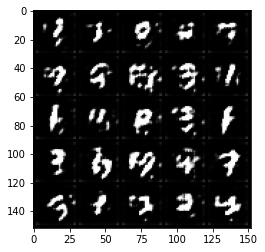

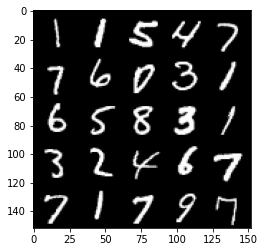

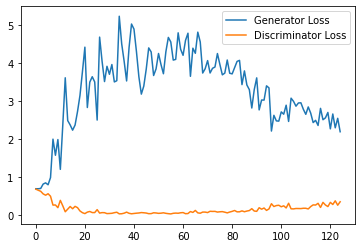

Step 3000: Generator loss: 2.33922243475914, discriminator loss: 0.3218674698472023


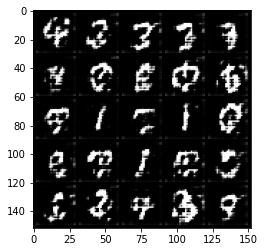

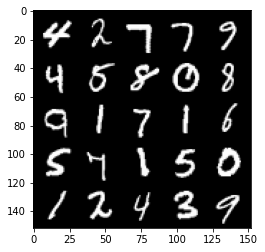

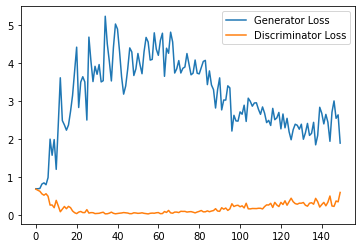

Step 3500: Generator loss: 2.026279924631119, discriminator loss: 0.3426573096215725


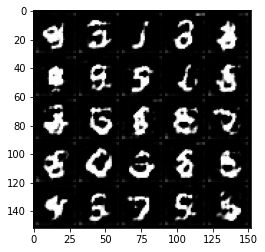

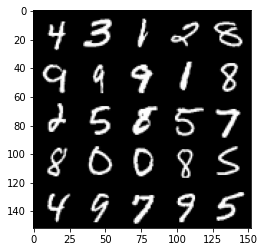

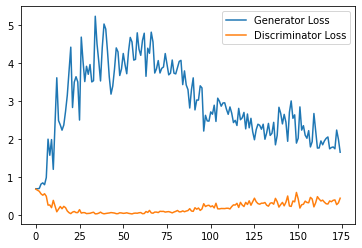

Step 4000: Generator loss: 1.961790778875351, discriminator loss: 0.3421697146892548


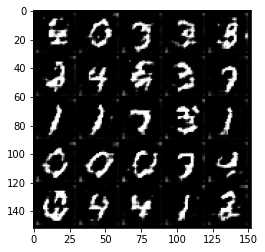

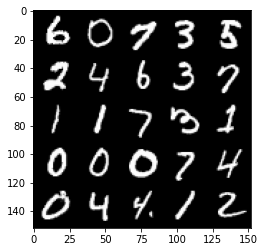

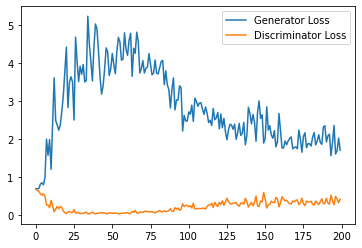

Step 4500: Generator loss: 1.8578319180011749, discriminator loss: 0.3599977170228958


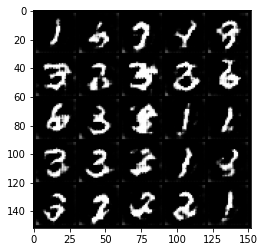

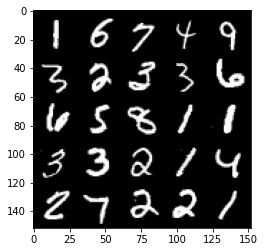

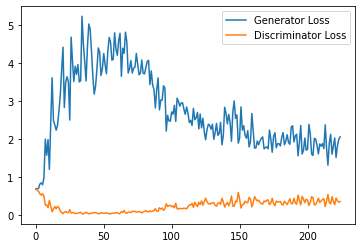

Step 5000: Generator loss: 1.7234849771261216, discriminator loss: 0.3751094114482403


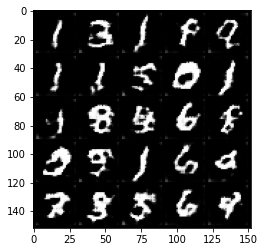

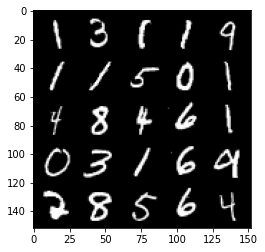

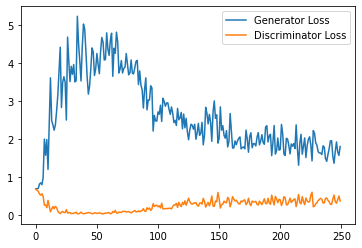

Step 5500: Generator loss: 1.657386911869049, discriminator loss: 0.41760171619057657


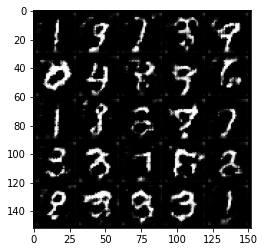

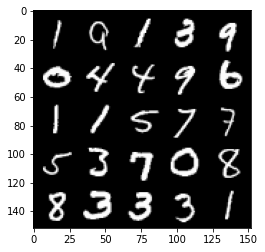

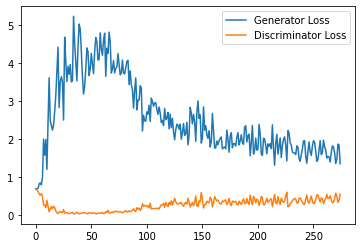

Step 6000: Generator loss: 1.6149594261646272, discriminator loss: 0.43888558143377304


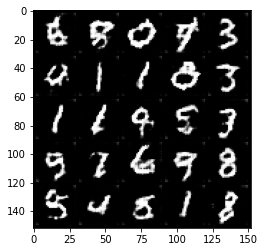

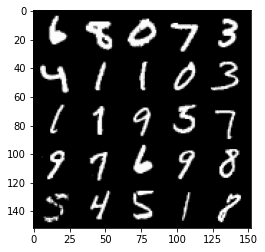

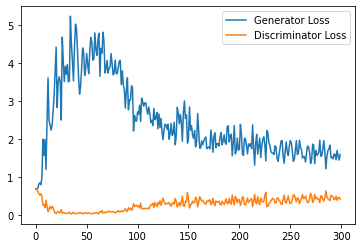

Step 6500: Generator loss: 1.5210727977752685, discriminator loss: 0.4596577855348587


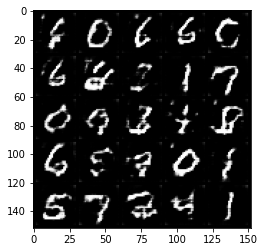

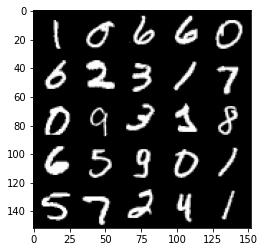

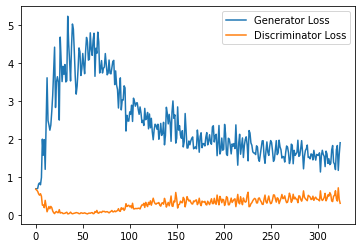

Step 7000: Generator loss: 1.4356341047286987, discriminator loss: 0.477850385427475


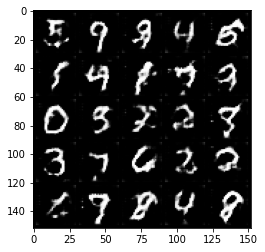

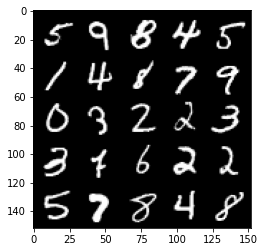

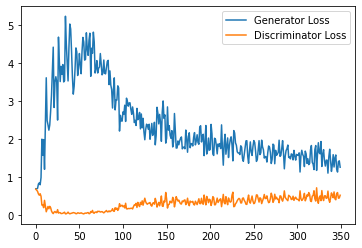

Step 7500: Generator loss: 1.3456672171354294, discriminator loss: 0.5010038118958473


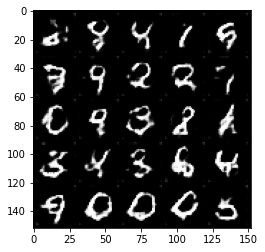

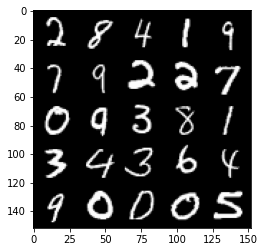

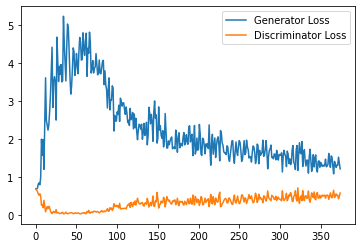

Step 8000: Generator loss: 1.3617416182756423, discriminator loss: 0.5114923695921898


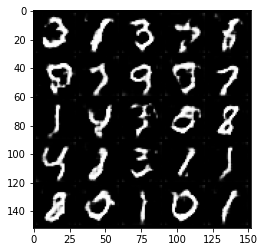

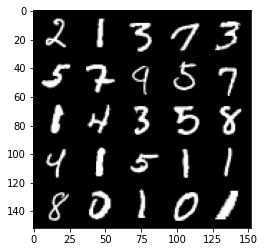

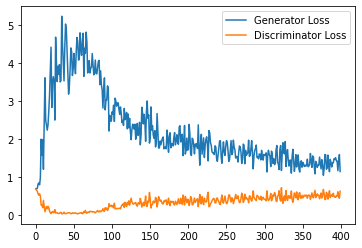

Step 8500: Generator loss: 1.2977712894678115, discriminator loss: 0.5265018242001533


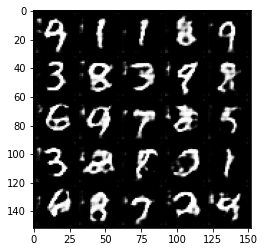

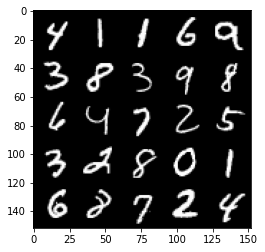

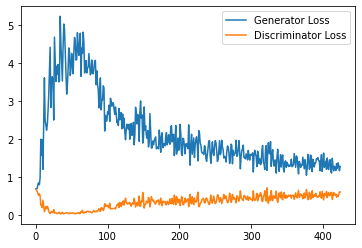

Step 9000: Generator loss: 1.28612400662899, discriminator loss: 0.5444097703099251


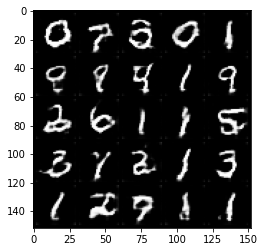

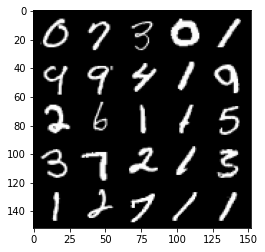

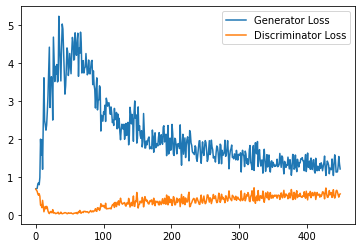

Step 9500: Generator loss: 1.2191510807275772, discriminator loss: 0.5555288315415382


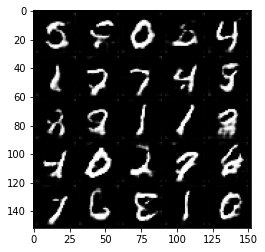

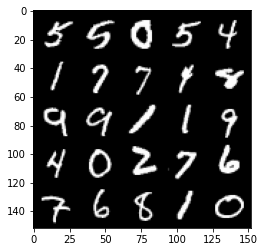

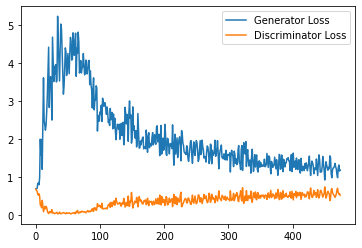

Step 10000: Generator loss: 1.1872968987226487, discriminator loss: 0.5555642907619476


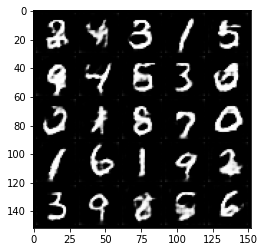

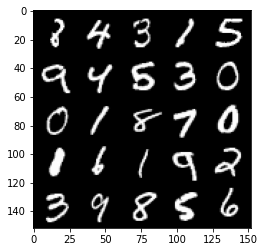

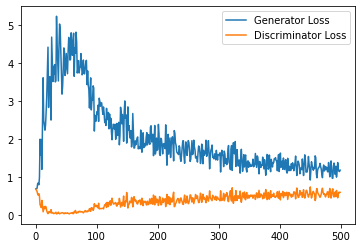

Step 10500: Generator loss: 1.176934208035469, discriminator loss: 0.5543048714399338


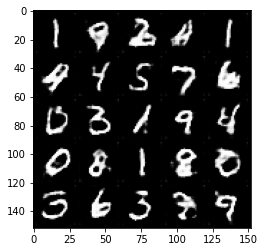

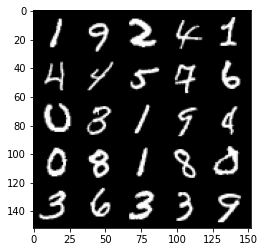

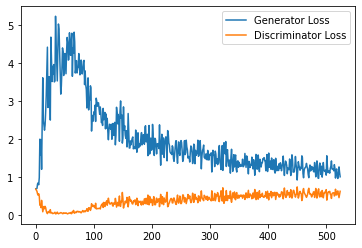

Step 11000: Generator loss: 1.1297975175380708, discriminator loss: 0.567131583571434


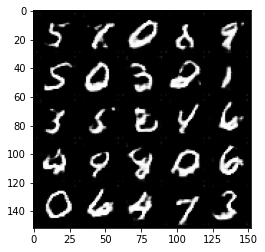

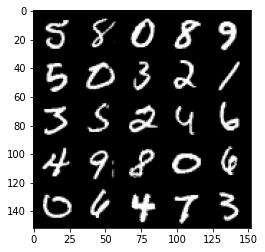

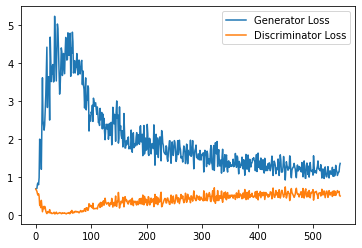

Step 11500: Generator loss: 1.1449679968357087, discriminator loss: 0.5749090946912766


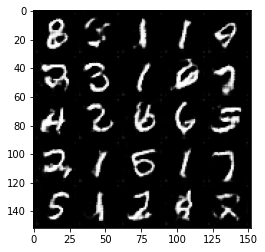

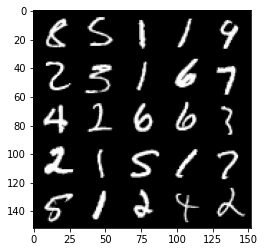

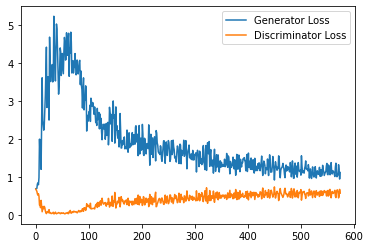

Step 12000: Generator loss: 1.1035629975795747, discriminator loss: 0.5625926872491837


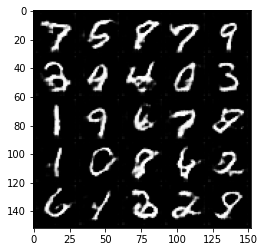

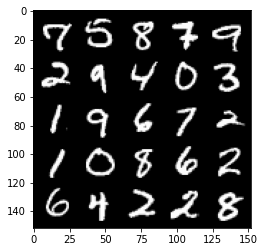

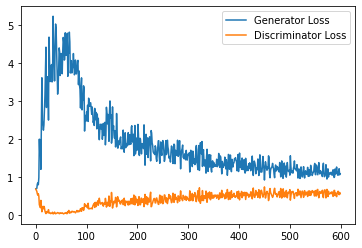

Step 12500: Generator loss: 1.109886401295662, discriminator loss: 0.5800825598835945


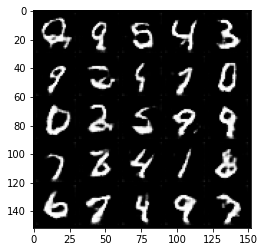

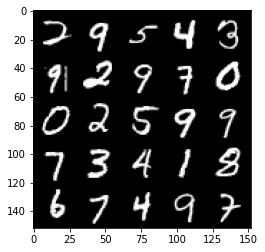

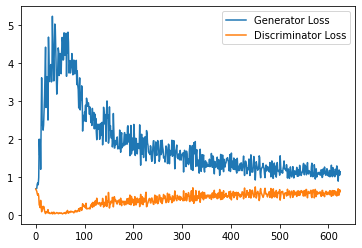

Step 13000: Generator loss: 1.1366957889795304, discriminator loss: 0.5763577725291252


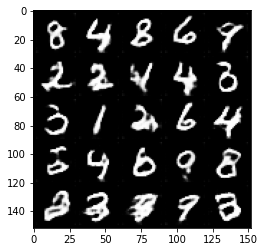

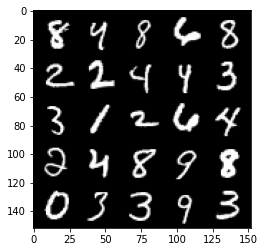

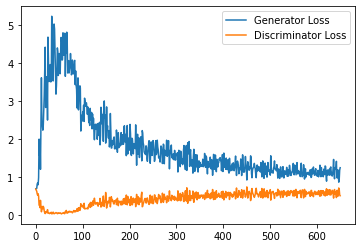

Step 13500: Generator loss: 1.0365053231716157, discriminator loss: 0.5969035866856575


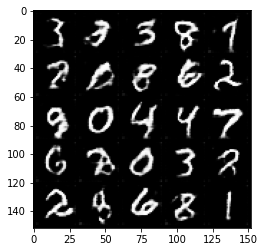

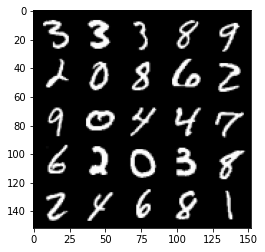

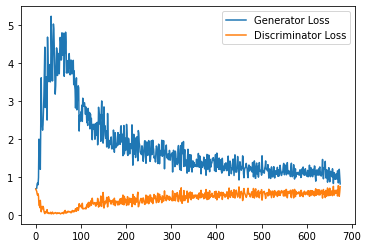

Step 14000: Generator loss: 1.0667349356412887, discriminator loss: 0.5838918634653092


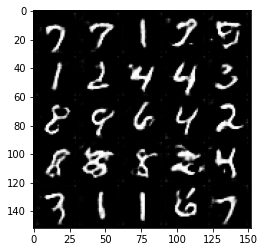

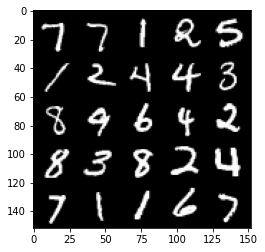

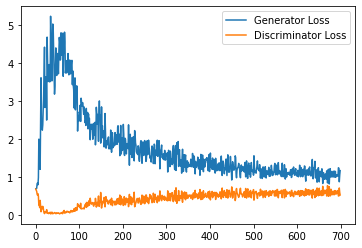

Step 14500: Generator loss: 1.0433101079463958, discriminator loss: 0.6099396960139275


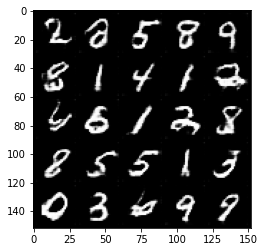

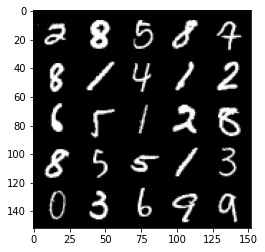

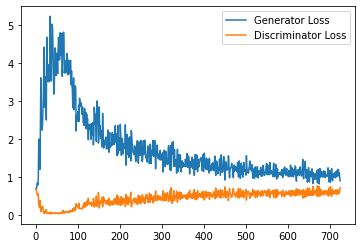

Step 15000: Generator loss: 1.024315027832985, discriminator loss: 0.6046300058364869


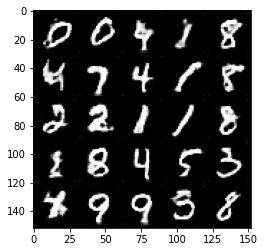

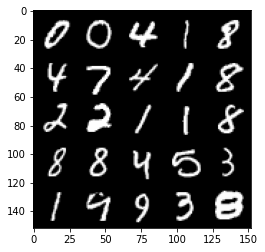

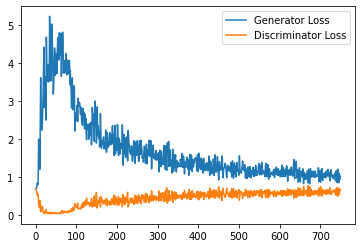

Step 15500: Generator loss: 1.016789447784424, discriminator loss: 0.5971447411179542


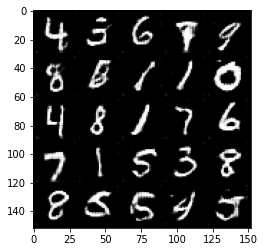

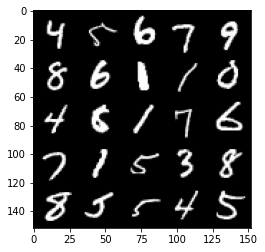

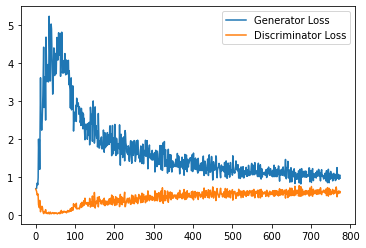

Step 16000: Generator loss: 0.9949422574043274, discriminator loss: 0.607046170949936


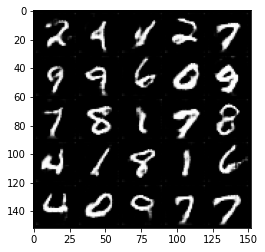

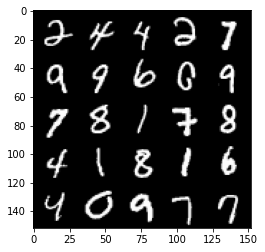

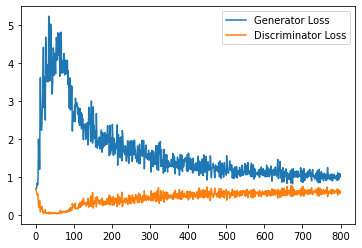

Step 16500: Generator loss: 0.9940785080194473, discriminator loss: 0.6018807936310768


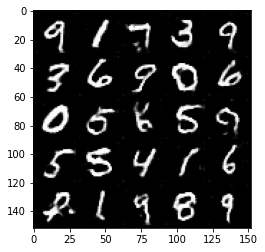

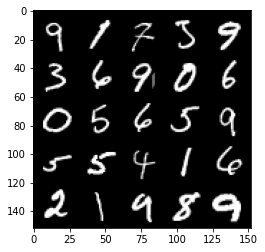

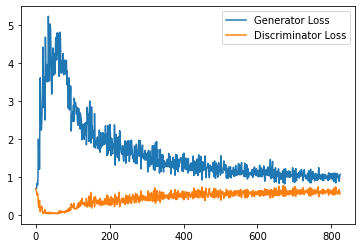

Step 17000: Generator loss: 0.9888134877681732, discriminator loss: 0.6100893954634666


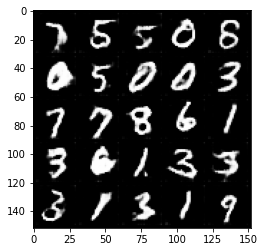

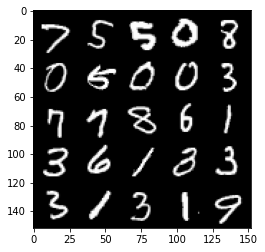

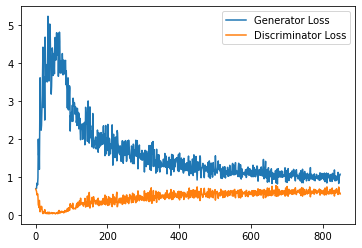

Step 17500: Generator loss: 0.9744922858476639, discriminator loss: 0.6051538708209991


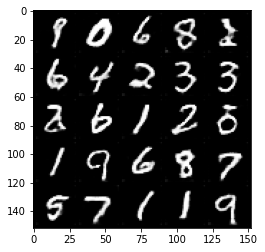

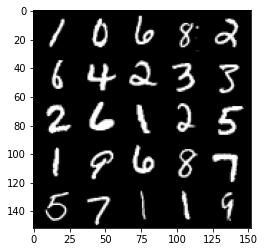

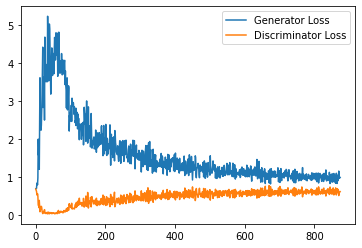

Step 18000: Generator loss: 1.0121010224819182, discriminator loss: 0.5972787072062492


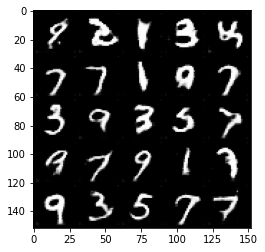

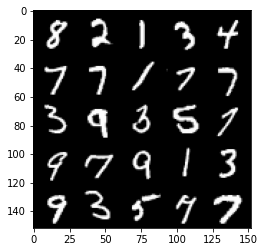

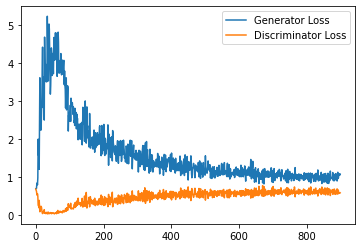

Step 18500: Generator loss: 0.9834514293670654, discriminator loss: 0.6068187854290008


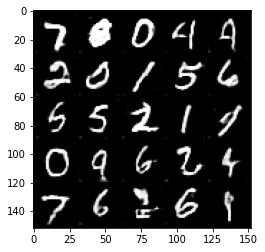

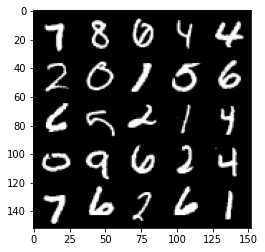

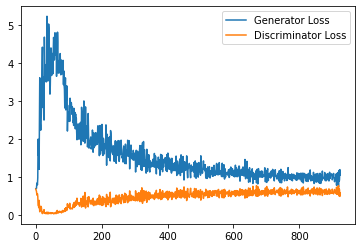

Step 19000: Generator loss: 0.9981599473953247, discriminator loss: 0.6103585500121117


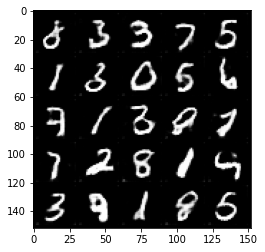

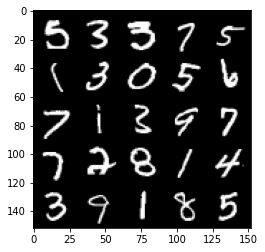

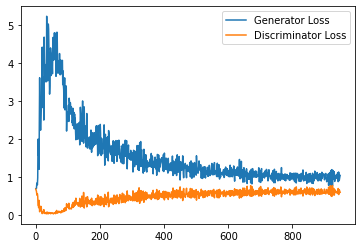

Step 19500: Generator loss: 0.9890727151632309, discriminator loss: 0.6010419991016388


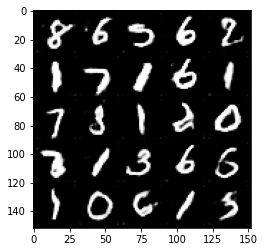

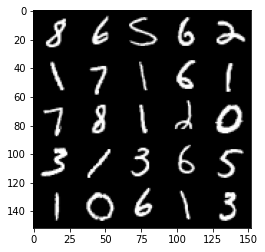

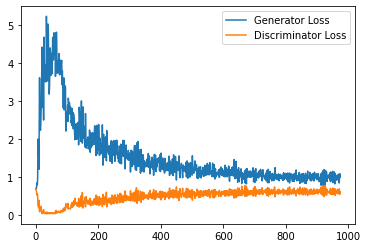

Step 20000: Generator loss: 0.9805080778598786, discriminator loss: 0.604051873087883


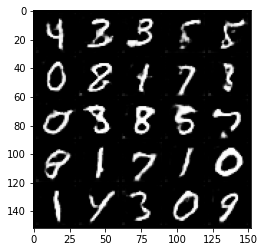

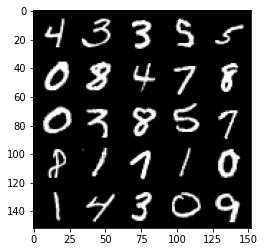

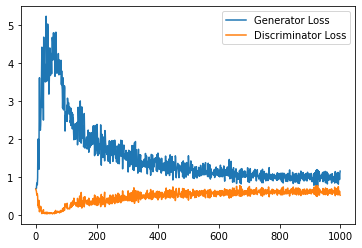

Step 20500: Generator loss: 0.9546970109939575, discriminator loss: 0.6165288965702057


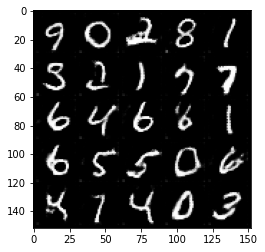

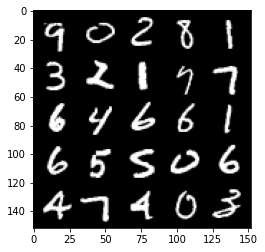

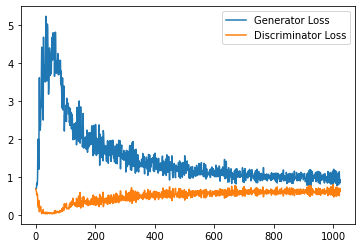

Step 21000: Generator loss: 0.966813488483429, discriminator loss: 0.6036812201738357


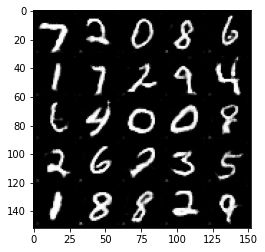

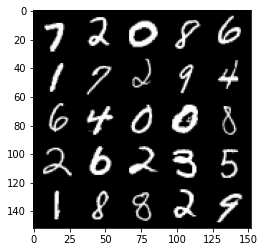

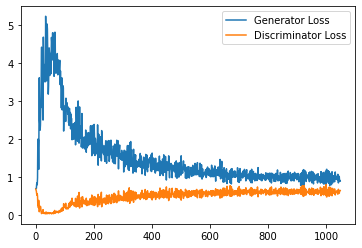

Step 21500: Generator loss: 0.9781951814889908, discriminator loss: 0.593162274479866


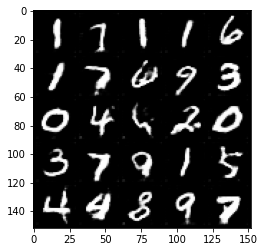

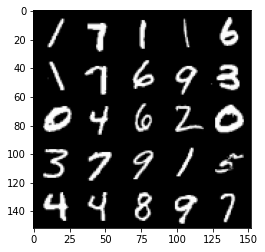

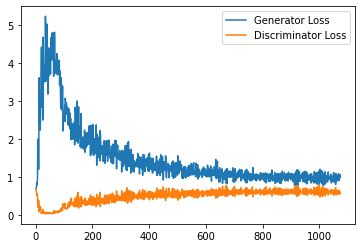

Step 22000: Generator loss: 0.9991876820325851, discriminator loss: 0.5996717578172683


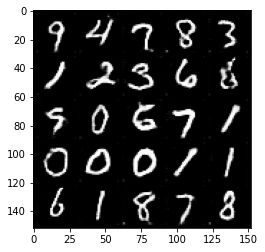

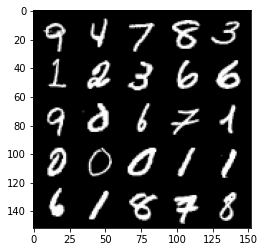

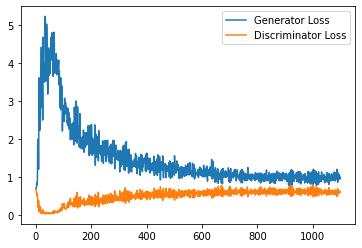

Step 22500: Generator loss: 1.0099780449867248, discriminator loss: 0.6063716400861741


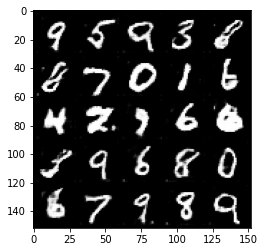

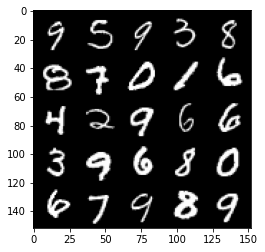

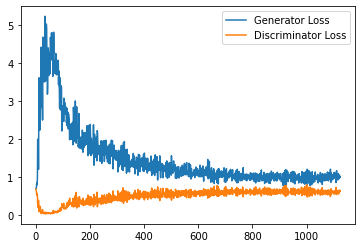

Step 23000: Generator loss: 0.9890330963134766, discriminator loss: 0.6041040012836456


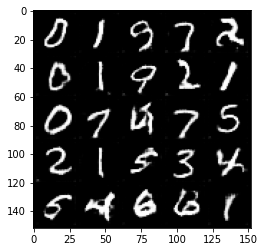

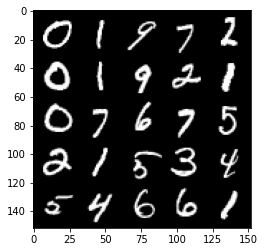

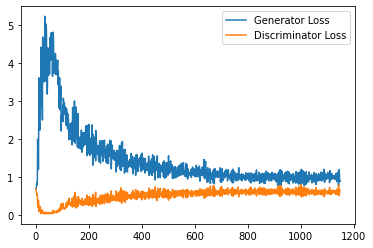

Step 23500: Generator loss: 0.9793630354404449, discriminator loss: 0.6014029335975647


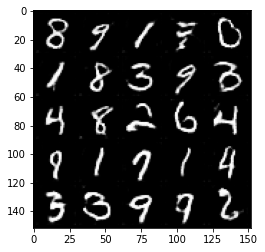

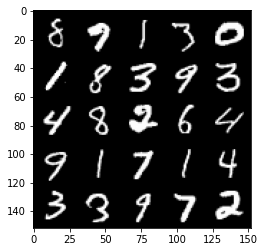

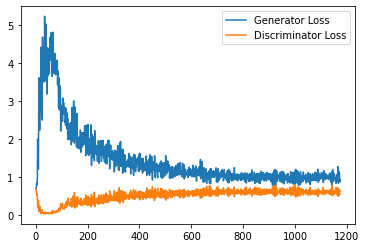

Step 24000: Generator loss: 0.9692095804214478, discriminator loss: 0.6030794333219528


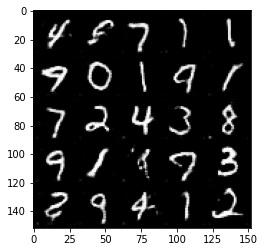

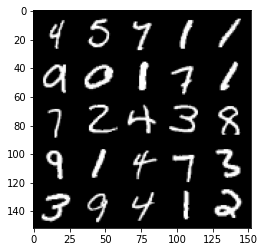

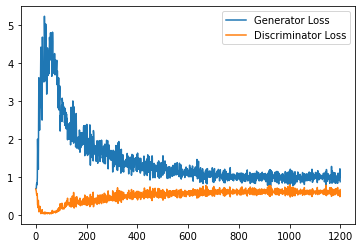

Step 24500: Generator loss: 0.9938685747385025, discriminator loss: 0.5969130737185478


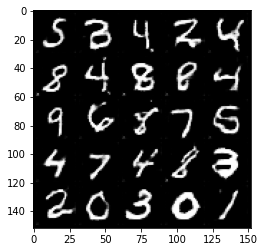

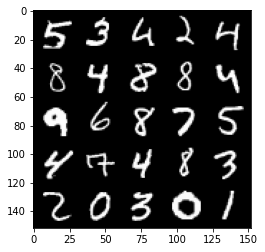

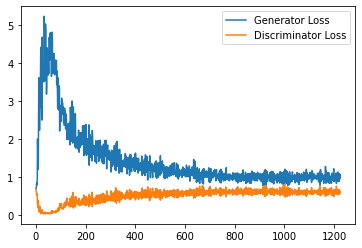

Step 25000: Generator loss: 0.9566862343549728, discriminator loss: 0.6002084698081016


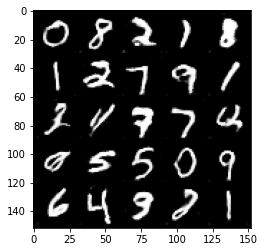

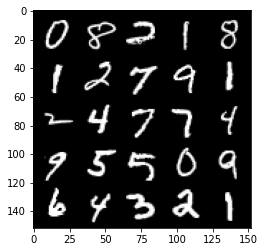

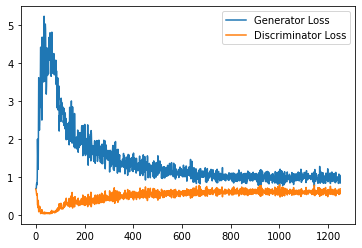

Step 25500: Generator loss: 0.9508592277765274, discriminator loss: 0.6059331874251366


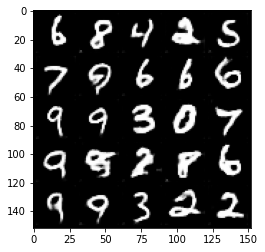

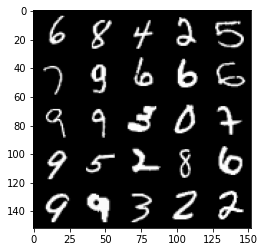

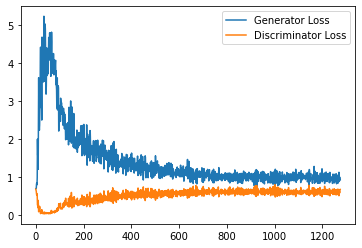

Step 26000: Generator loss: 0.9627172868251801, discriminator loss: 0.5947651211619377


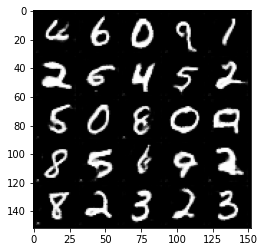

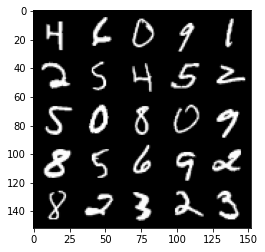

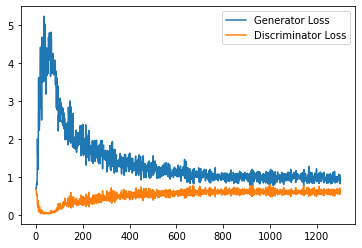

Step 26500: Generator loss: 0.9958433395624161, discriminator loss: 0.5916983916163444


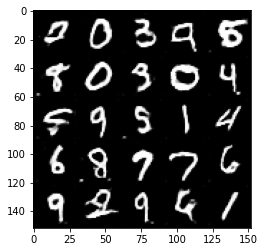

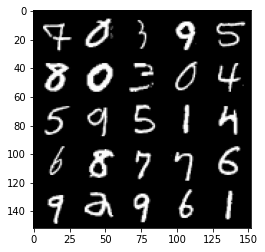

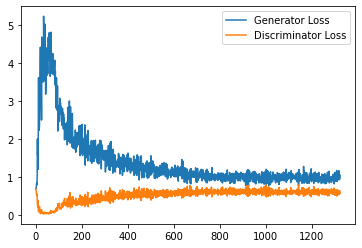

Step 27000: Generator loss: 0.9599886565208435, discriminator loss: 0.598744521021843


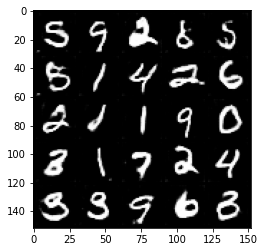

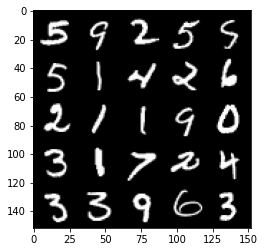

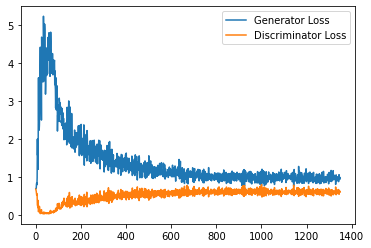

Step 27500: Generator loss: 0.9765358864068985, discriminator loss: 0.5939476653337479


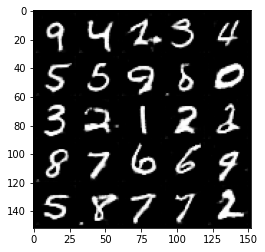

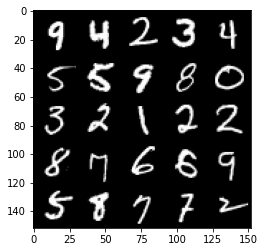

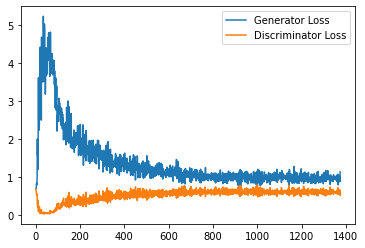

Step 28000: Generator loss: 0.98748661673069, discriminator loss: 0.5986885014176369


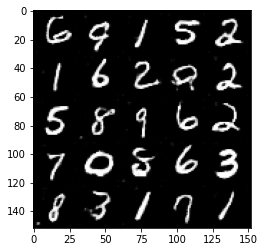

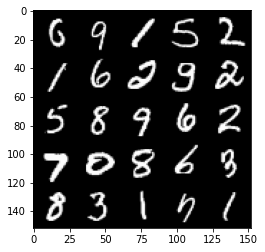

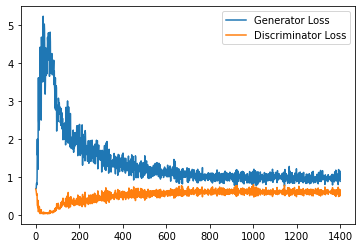

Step 28500: Generator loss: 0.9902851485013962, discriminator loss: 0.5988114129304886


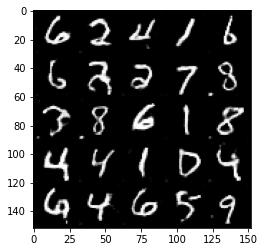

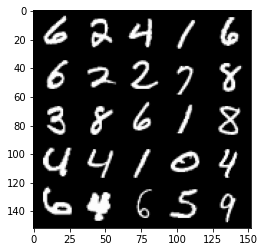

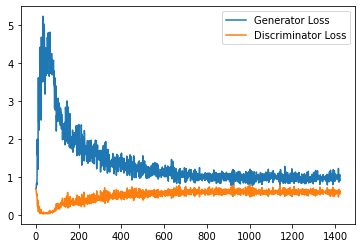

Step 29000: Generator loss: 0.9634488950967789, discriminator loss: 0.5972391002178192


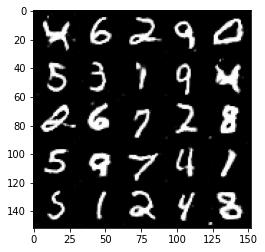

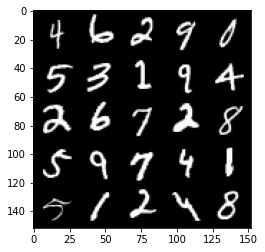

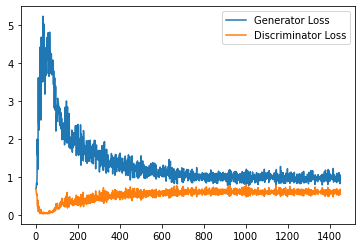

Step 29500: Generator loss: 0.9767537877559662, discriminator loss: 0.5961907166242599


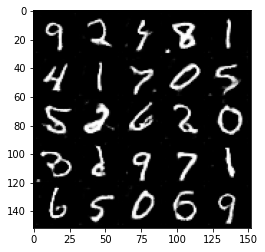

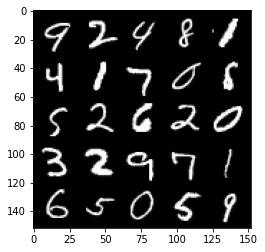

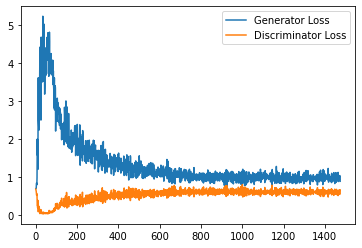

Step 30000: Generator loss: 0.9803356887102127, discriminator loss: 0.596915596306324


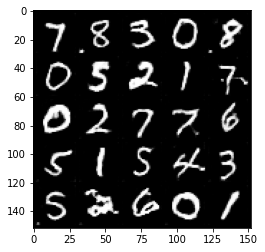

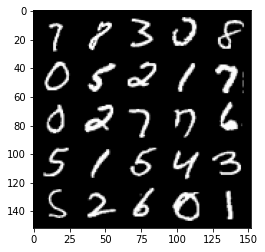

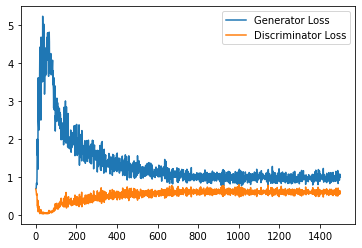

Step 30500: Generator loss: 0.9664380358457565, discriminator loss: 0.5966188047528267


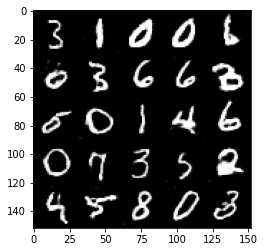

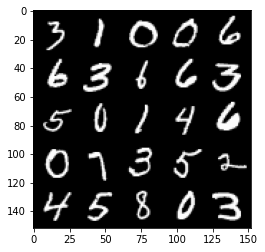

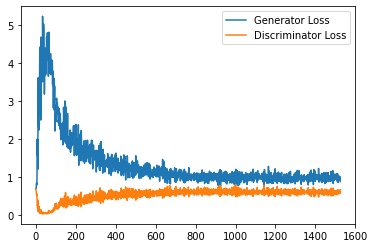

Step 31000: Generator loss: 0.9698607242107391, discriminator loss: 0.5961426321864128


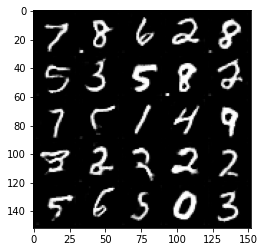

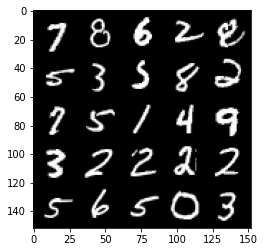

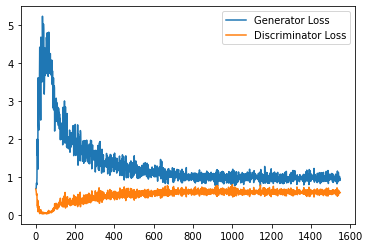

Step 31500: Generator loss: 0.9483290053606034, discriminator loss: 0.5999817481637001


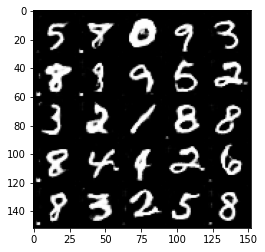

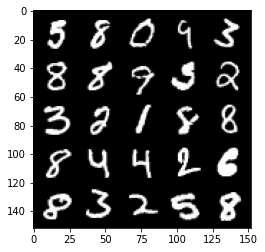

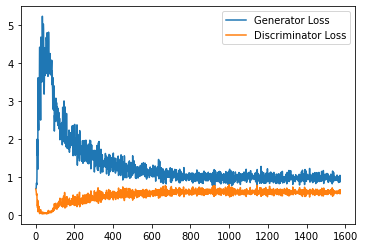

Step 32000: Generator loss: 0.9647321834564209, discriminator loss: 0.5942104092240333


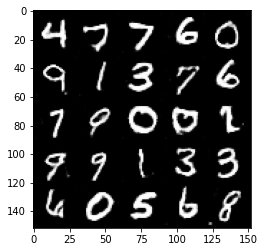

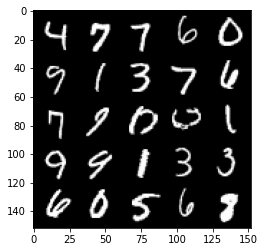

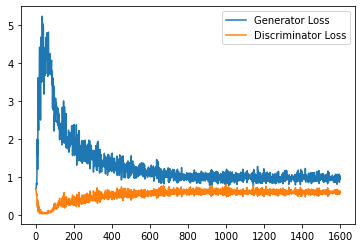

Step 32500: Generator loss: 0.9585070439577102, discriminator loss: 0.5960396861433983


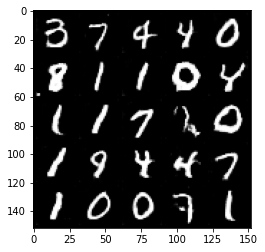

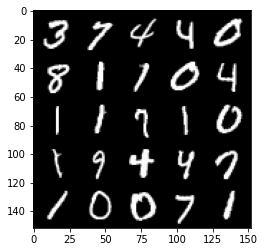

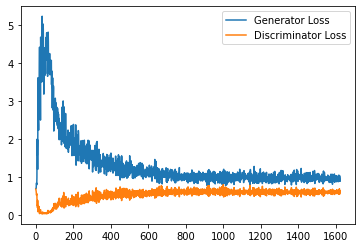

Step 33000: Generator loss: 0.9651633412837982, discriminator loss: 0.5975474632382393


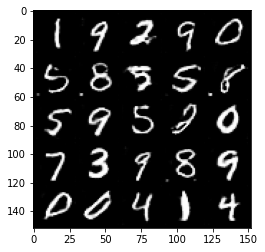

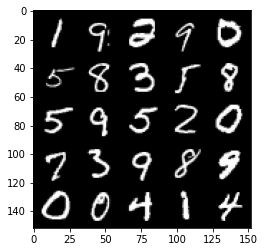

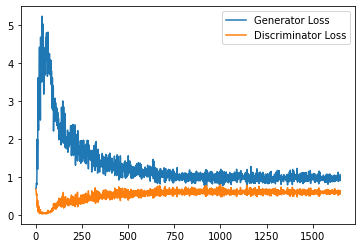

Step 33500: Generator loss: 0.9599649643898011, discriminator loss: 0.6043476413488388


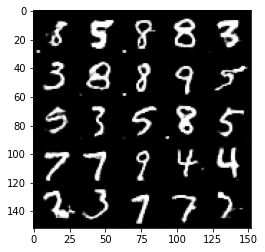

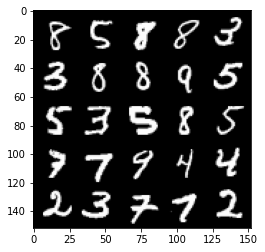

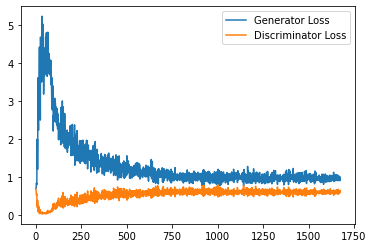

Step 34000: Generator loss: 0.9530196070671082, discriminator loss: 0.5973088787198066


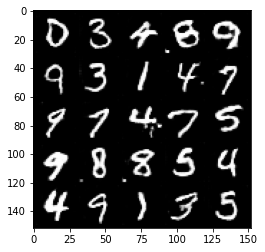

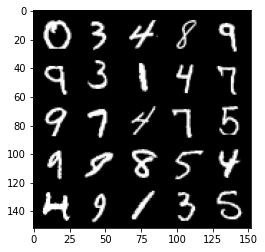

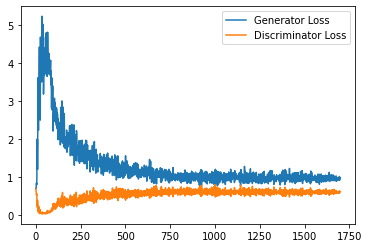

Step 34500: Generator loss: 0.9591771051883697, discriminator loss: 0.6000502048134804


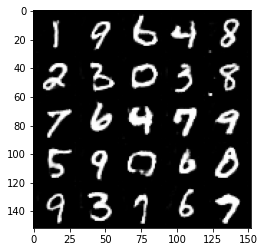

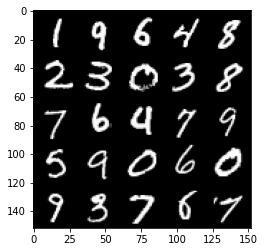

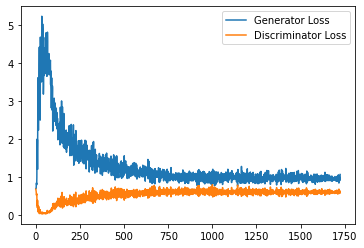

Step 35000: Generator loss: 0.9762288802862167, discriminator loss: 0.5971518757343293


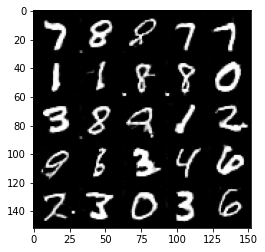

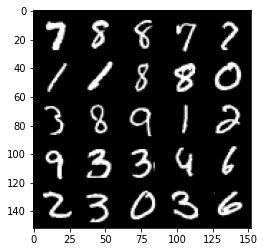

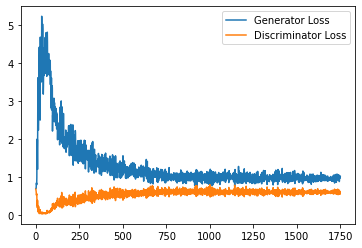

Step 35500: Generator loss: 0.9530323094129562, discriminator loss: 0.6007118220329285


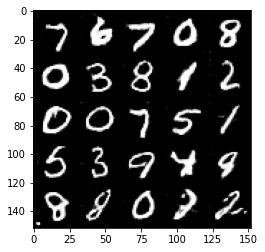

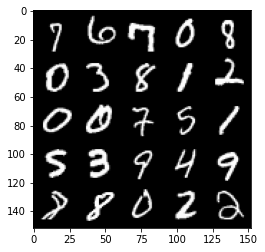

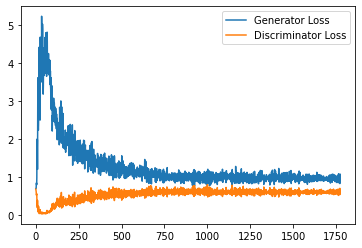

Step 36000: Generator loss: 0.956725426197052, discriminator loss: 0.6045560412406922


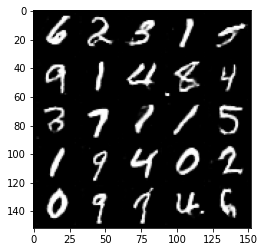

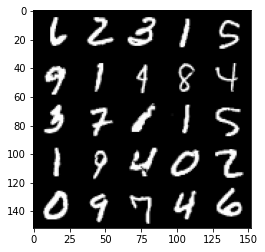

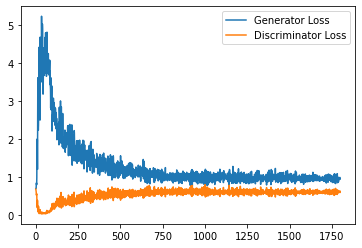

Step 36500: Generator loss: 0.962888209104538, discriminator loss: 0.6053330497145653


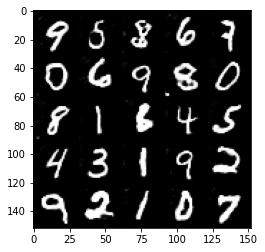

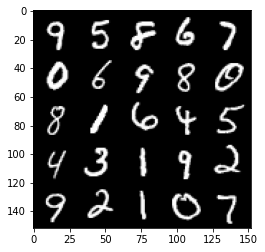

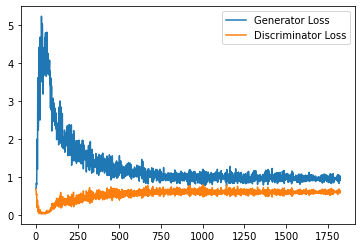

Step 37000: Generator loss: 0.9776788247823716, discriminator loss: 0.6017950314879418


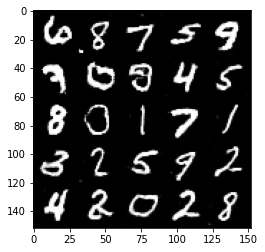

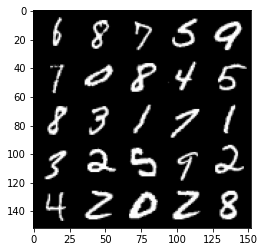

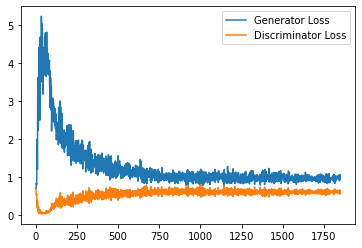

Step 37500: Generator loss: 1.0010749171972275, discriminator loss: 0.6020086748600006


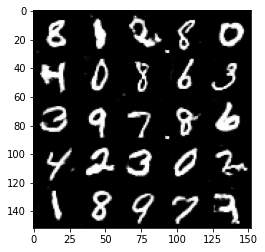

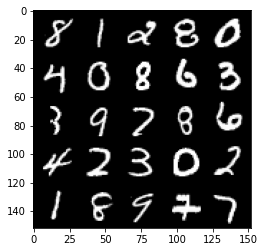

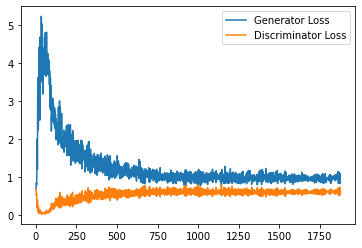

Step 38000: Generator loss: 0.9578672404289246, discriminator loss: 0.6023960196375847


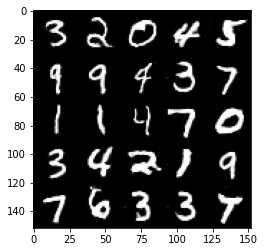

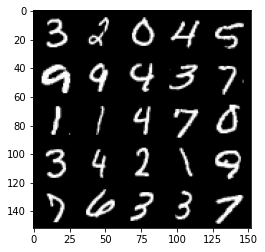

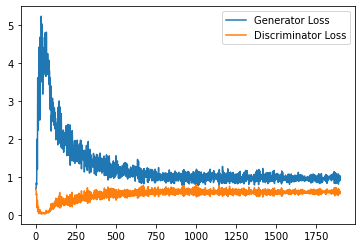

Step 38500: Generator loss: 0.9565296655893326, discriminator loss: 0.6022797607183457


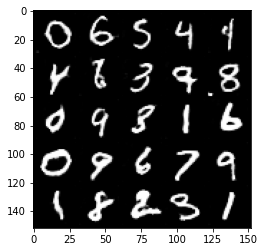

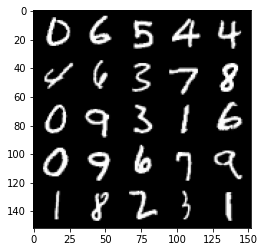

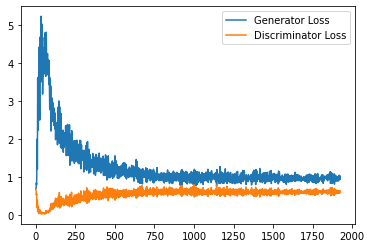

Step 39000: Generator loss: 0.9521132816076279, discriminator loss: 0.6019503463506699


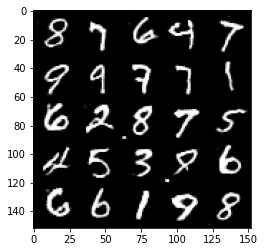

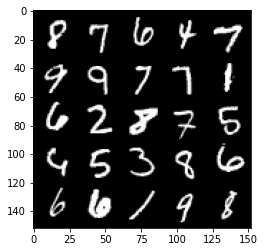

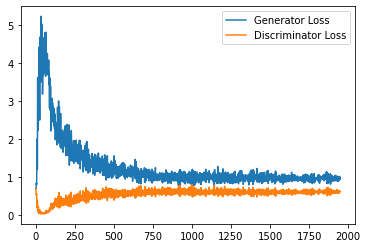

Step 39500: Generator loss: 0.9829391980171204, discriminator loss: 0.6030444539189339


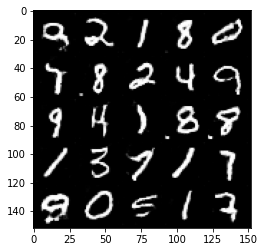

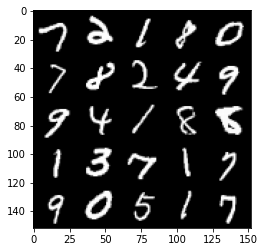

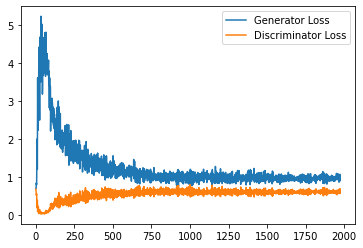

Step 40000: Generator loss: 0.9558873716592788, discriminator loss: 0.6047825750112533


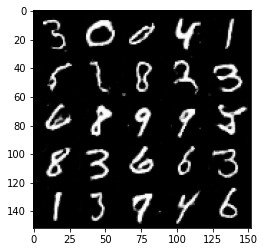

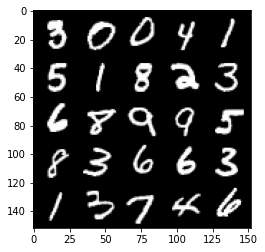

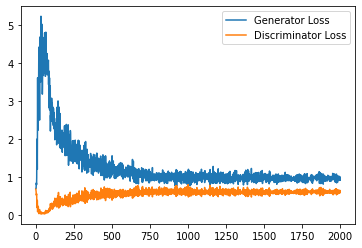

Step 40500: Generator loss: 0.9705669949054718, discriminator loss: 0.602599825143814


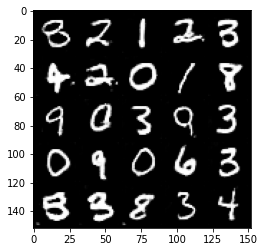

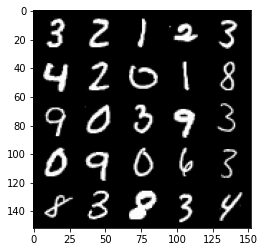

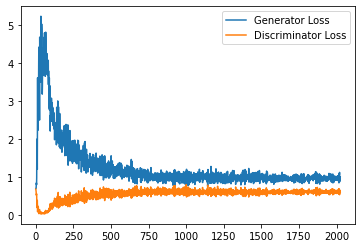

Step 41000: Generator loss: 0.9704887311458588, discriminator loss: 0.6024458845257759


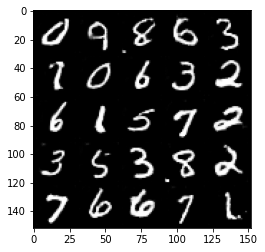

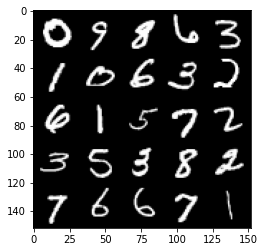

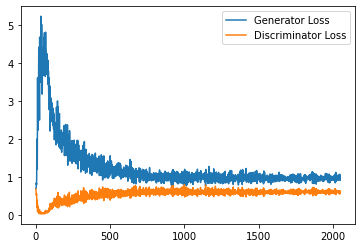

Step 41500: Generator loss: 0.9716406508684158, discriminator loss: 0.6036681862473487


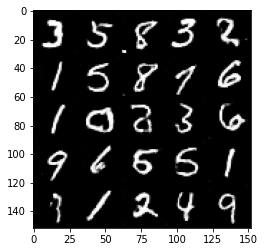

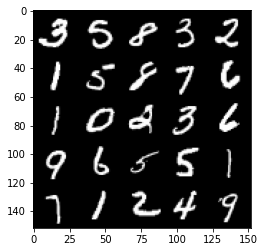

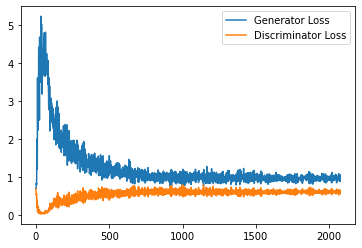

Step 42000: Generator loss: 0.9834353396892548, discriminator loss: 0.6000468626618385


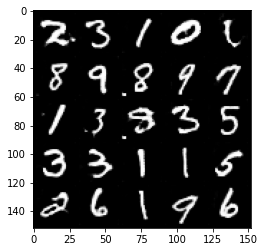

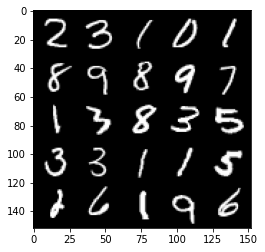

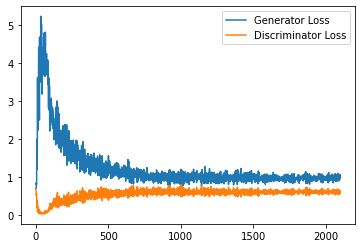

Step 42500: Generator loss: 0.9776747757196427, discriminator loss: 0.6002267968058587


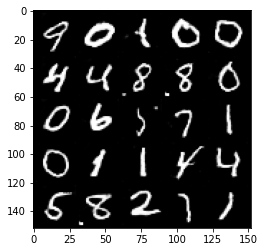

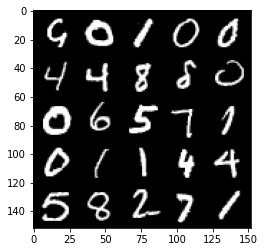

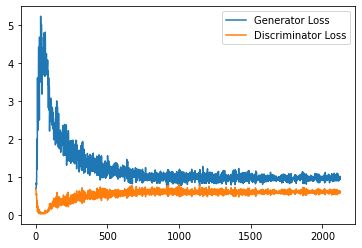

Step 43000: Generator loss: 0.9577055671215058, discriminator loss: 0.6014701082110405


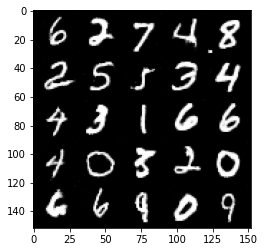

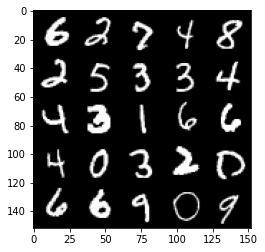

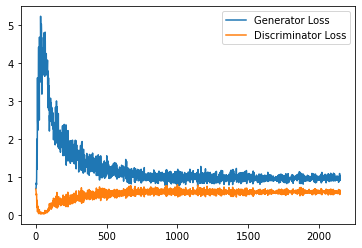

Step 43500: Generator loss: 0.9622722275257111, discriminator loss: 0.6004993009567261


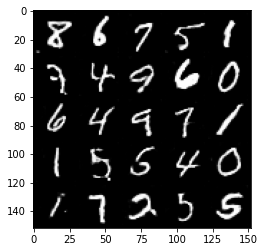

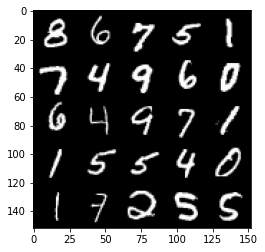

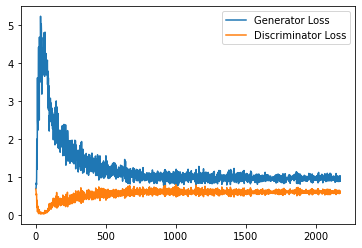

Step 44000: Generator loss: 0.9640017293691635, discriminator loss: 0.6017154456973076


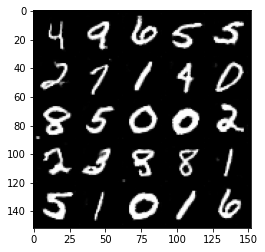

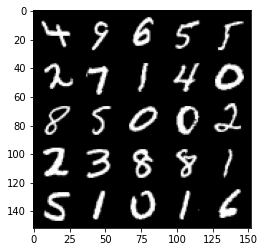

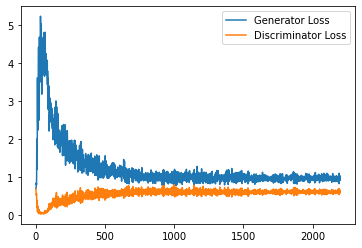

Step 44500: Generator loss: 0.9621066236495972, discriminator loss: 0.5996002029776574


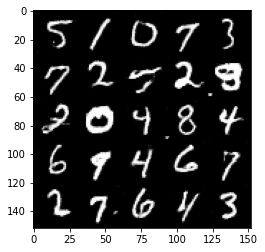

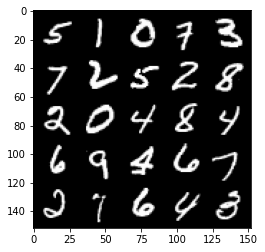

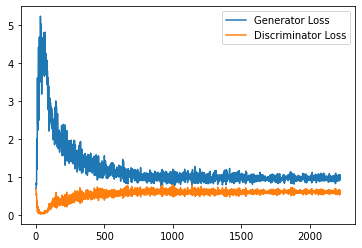

Step 45000: Generator loss: 0.9748419340848923, discriminator loss: 0.6009759898781777


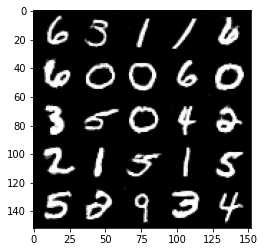

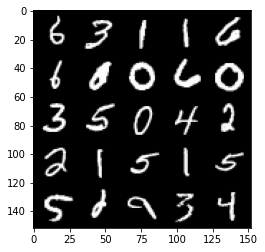

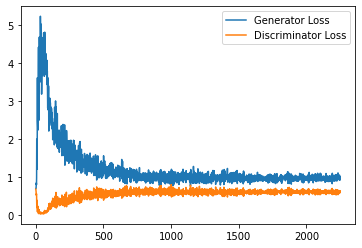

Step 45500: Generator loss: 0.9700404498577118, discriminator loss: 0.6002867811322212


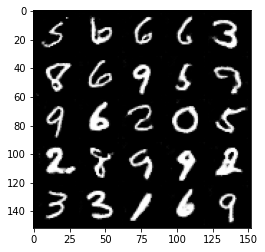

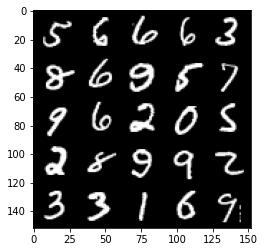

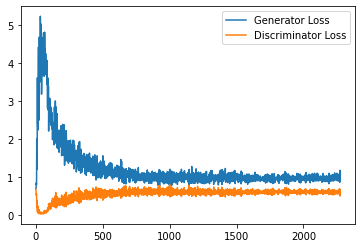

Step 46000: Generator loss: 0.9690948601961136, discriminator loss: 0.5997282996177673


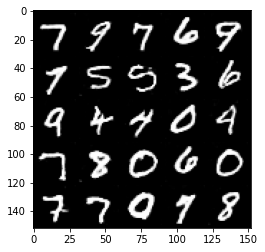

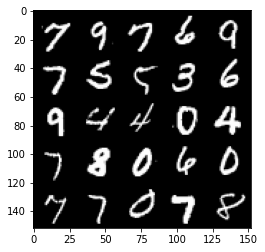

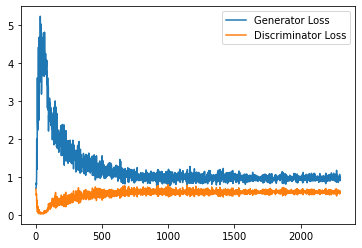

Step 46500: Generator loss: 0.9793237184286118, discriminator loss: 0.6011863508820534


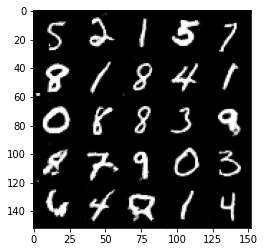

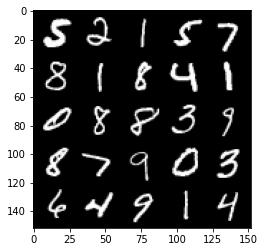

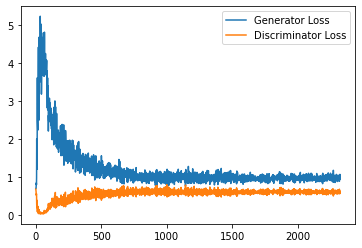

Step 47000: Generator loss: 0.9851700129508972, discriminator loss: 0.5986524248123168


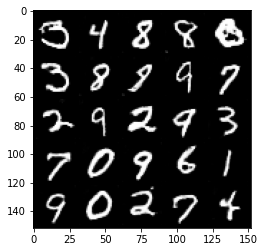

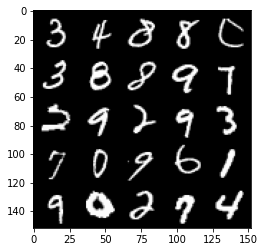

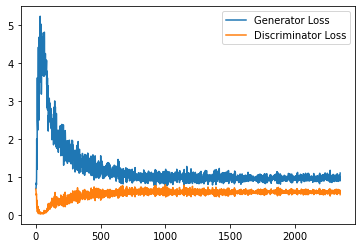

Step 47500: Generator loss: 0.9706461620330811, discriminator loss: 0.6022042338252067


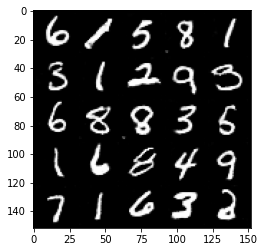

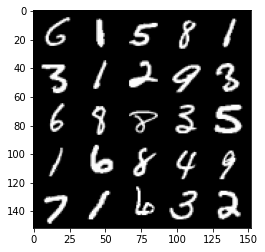

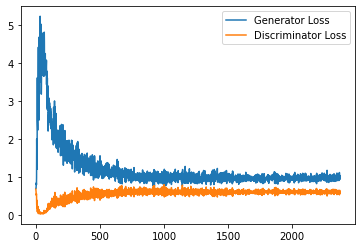

Step 48000: Generator loss: 0.978513356089592, discriminator loss: 0.6012035176753998


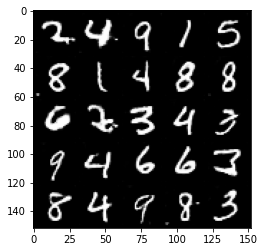

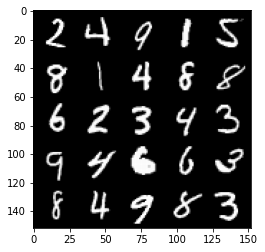

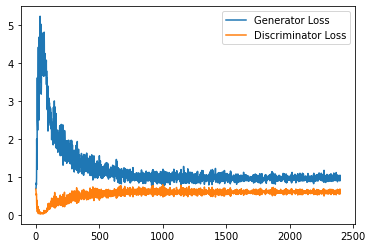

Step 48500: Generator loss: 0.9658153204917908, discriminator loss: 0.6034136649370193


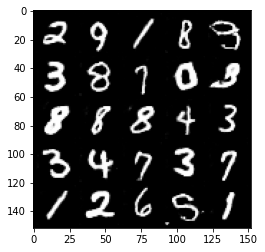

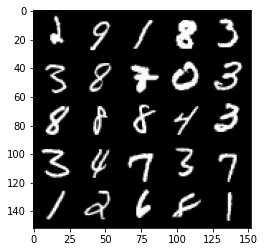

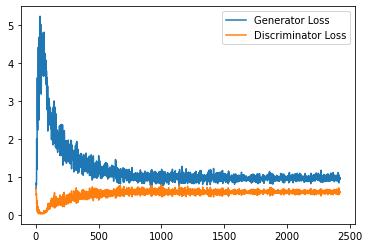

Step 49000: Generator loss: 0.9913945527076721, discriminator loss: 0.5956260822415352


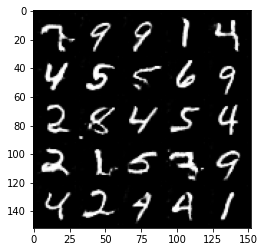

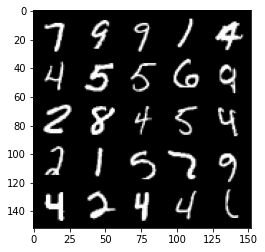

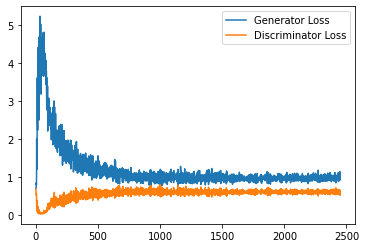

Step 49500: Generator loss: 0.9948718183040619, discriminator loss: 0.598252642095089


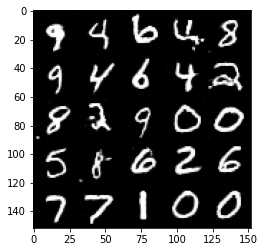

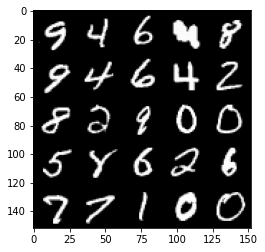

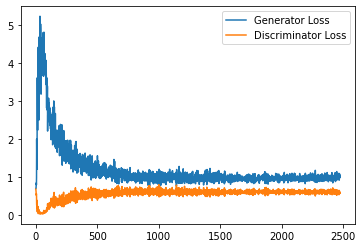

Step 50000: Generator loss: 0.9721681592464447, discriminator loss: 0.6013010122179985


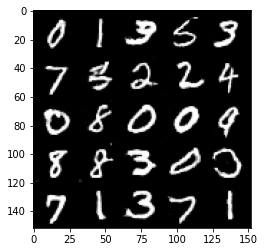

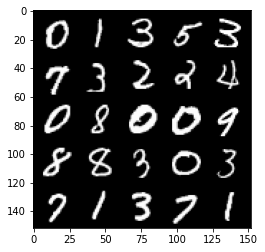

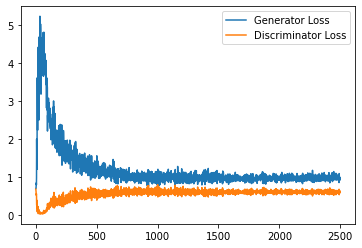

Step 50500: Generator loss: 0.9719978581666946, discriminator loss: 0.5968733537793159


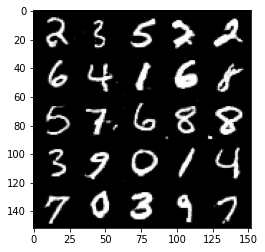

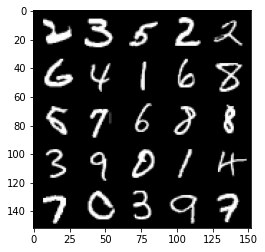

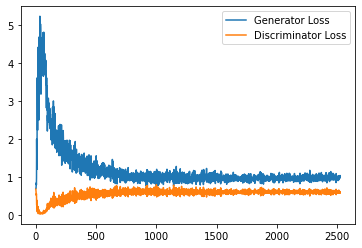

Step 51000: Generator loss: 0.9917830249071121, discriminator loss: 0.5995116111040115


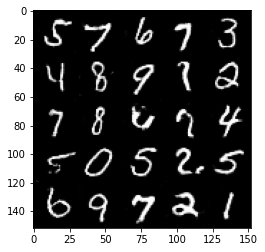

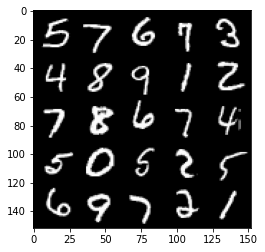

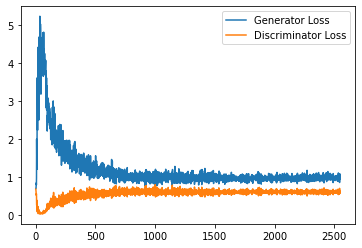

Step 51500: Generator loss: 0.9742846635580062, discriminator loss: 0.6007634407281875


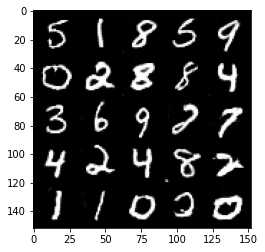

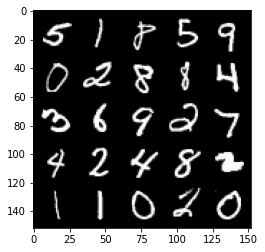

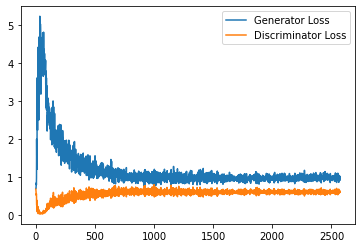

Step 52000: Generator loss: 0.9810961074829102, discriminator loss: 0.5971552083492279


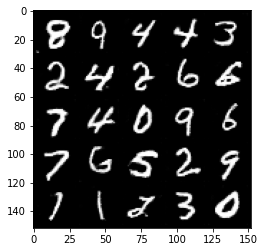

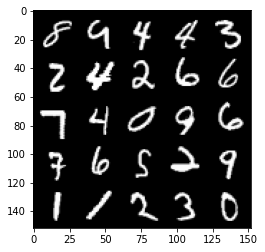

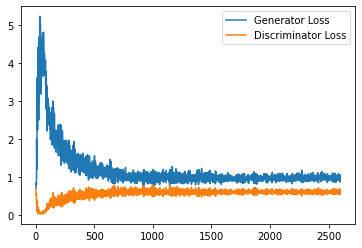

Step 52500: Generator loss: 0.9950400276184082, discriminator loss: 0.5961394385695458


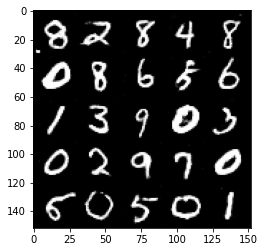

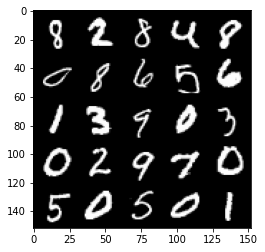

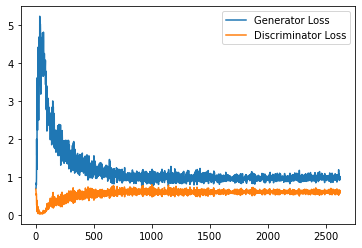

Step 53000: Generator loss: 0.9897951922416687, discriminator loss: 0.5995888072252273


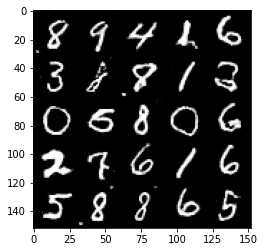

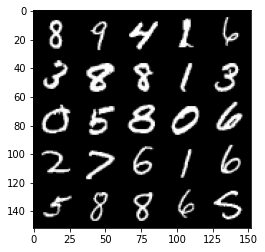

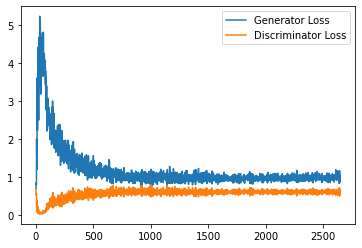

Step 53500: Generator loss: 0.9940052307844162, discriminator loss: 0.5974134508371353


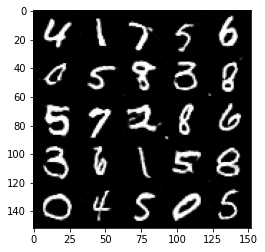

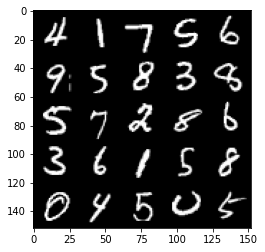

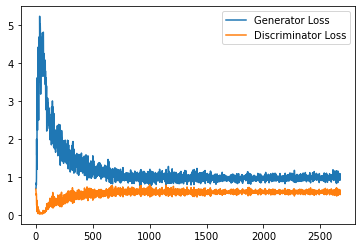

Step 54000: Generator loss: 0.9705327645540237, discriminator loss: 0.6013006124496459


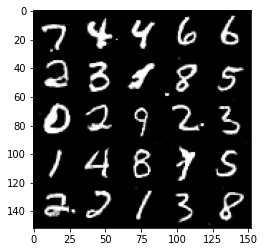

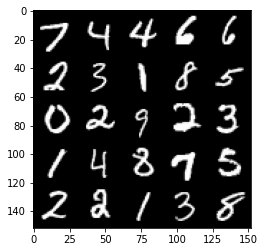

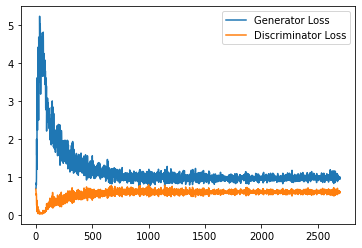

Step 54500: Generator loss: 0.9706898103952408, discriminator loss: 0.6019217364788055


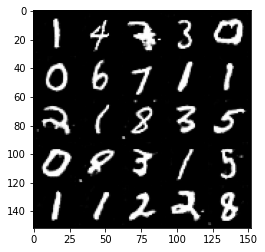

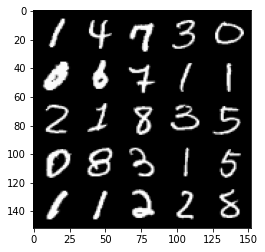

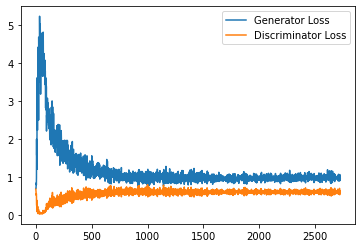

Step 55000: Generator loss: 0.9802066217660904, discriminator loss: 0.5914083493351936


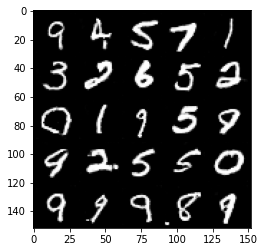

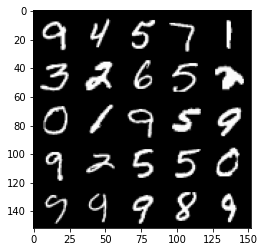

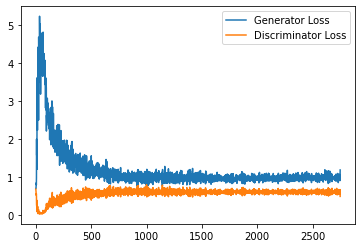

Step 55500: Generator loss: 0.9881461670398712, discriminator loss: 0.6026139938235283


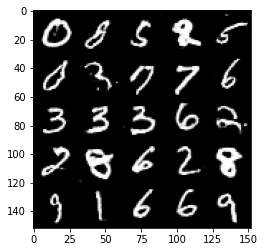

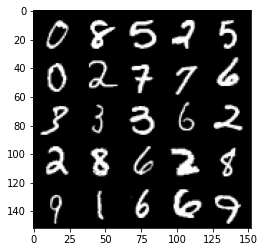

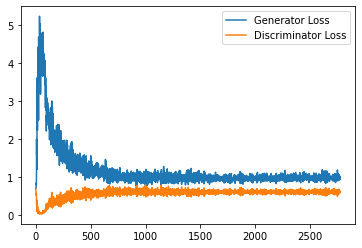

Step 56000: Generator loss: 0.9884557446241379, discriminator loss: 0.6017130133509636


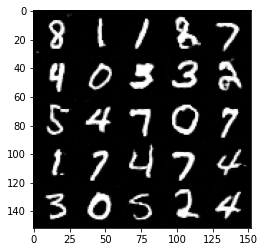

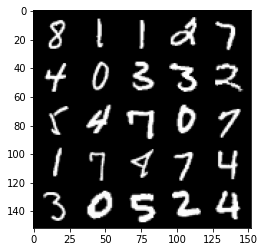

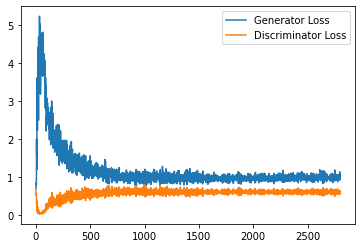

Step 56500: Generator loss: 0.997188266158104, discriminator loss: 0.5904077338576317


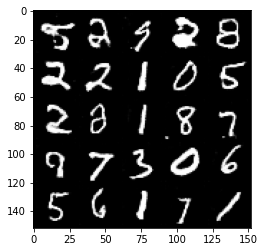

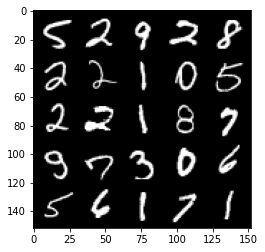

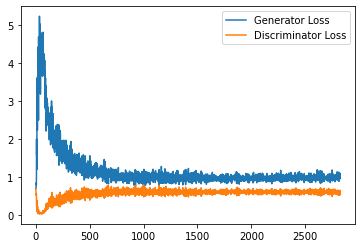

Step 57000: Generator loss: 0.9967709827423096, discriminator loss: 0.5947348662018775


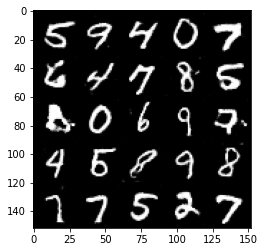

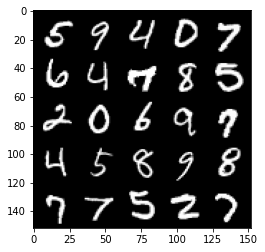

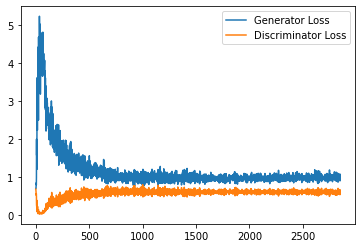

Step 57500: Generator loss: 0.991134086728096, discriminator loss: 0.5911300877928733


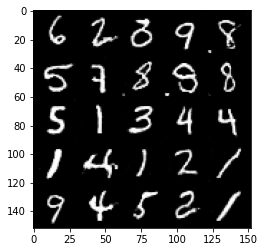

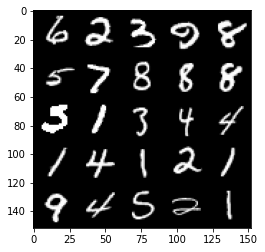

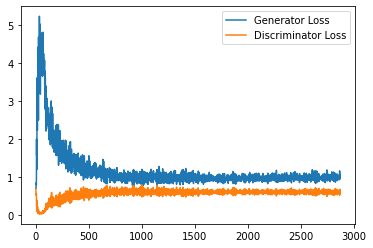

Step 58000: Generator loss: 1.0078100159168244, discriminator loss: 0.5932096467018128


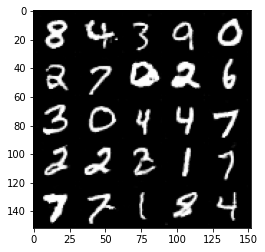

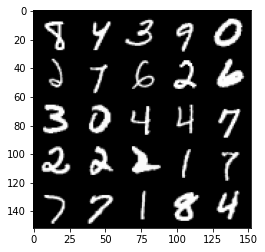

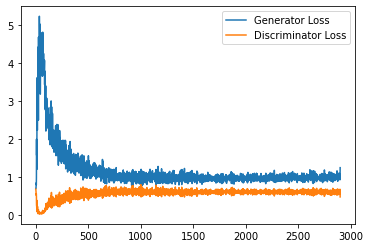

Step 58500: Generator loss: 0.999168071269989, discriminator loss: 0.5991965525746346


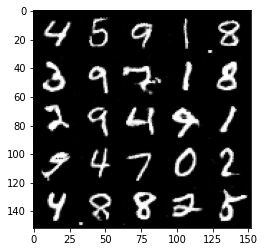

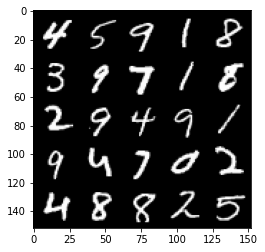

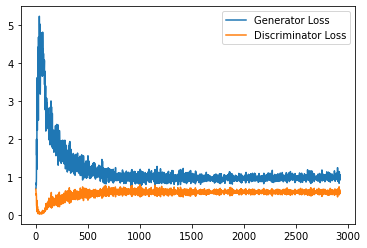

Step 59000: Generator loss: 0.9901614598035813, discriminator loss: 0.595919948875904


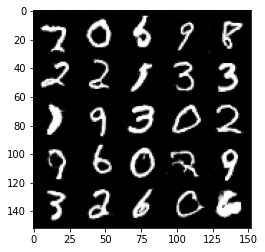

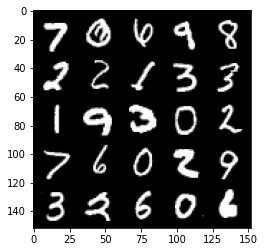

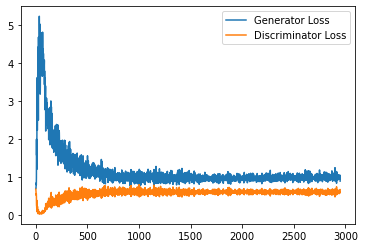

Step 59500: Generator loss: 1.0034817399978637, discriminator loss: 0.5945161378979683


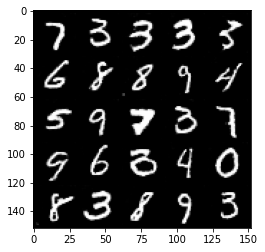

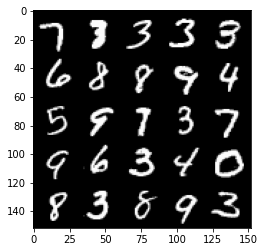

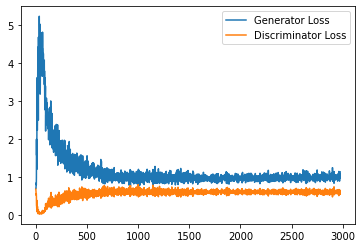

Step 60000: Generator loss: 1.0176020435094832, discriminator loss: 0.5938986068964005


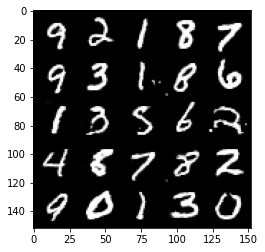

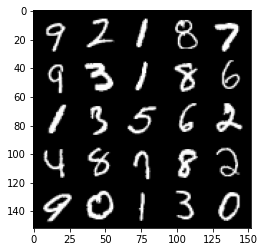

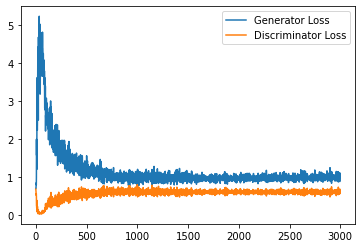

Step 60500: Generator loss: 1.0006568558216096, discriminator loss: 0.5922363561987877


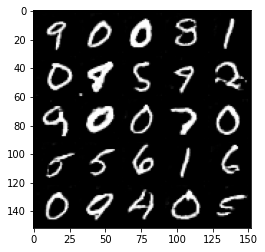

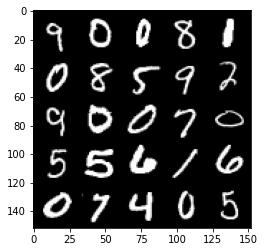

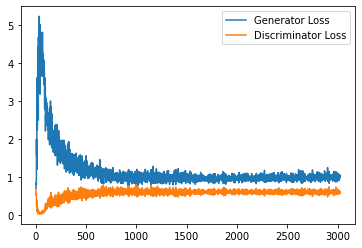

Step 61000: Generator loss: 1.007803867340088, discriminator loss: 0.5963163649439812


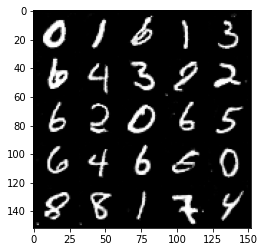

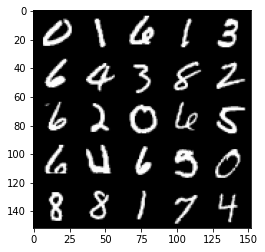

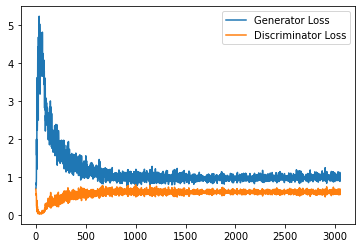

Step 61500: Generator loss: 0.985306240439415, discriminator loss: 0.5948535776138306


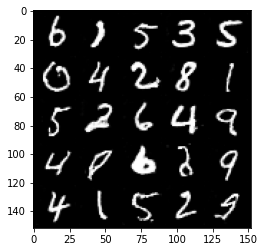

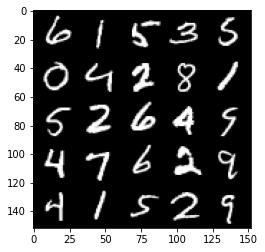

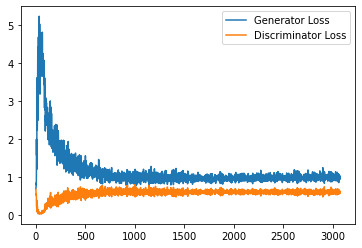

Step 62000: Generator loss: 0.9874280433654785, discriminator loss: 0.5920744921565055


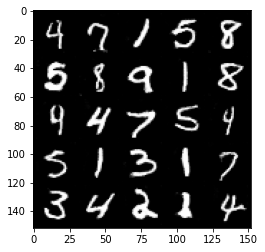

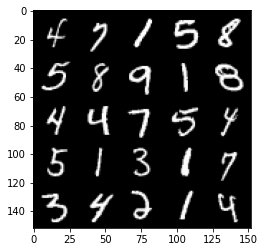

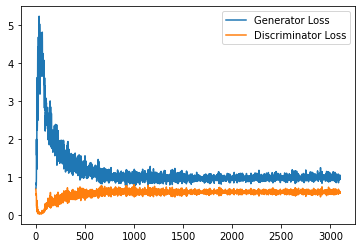

Step 62500: Generator loss: 1.0071047607660293, discriminator loss: 0.5893930998444558


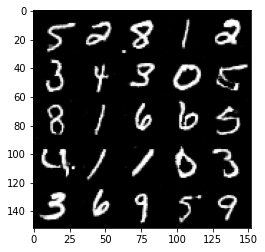

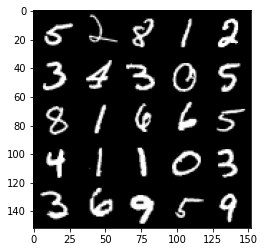

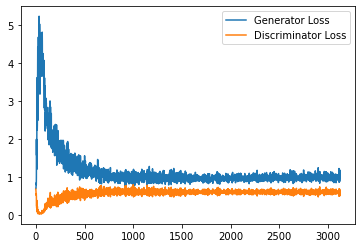

Step 63000: Generator loss: 0.9992174595594406, discriminator loss: 0.5994851852655411


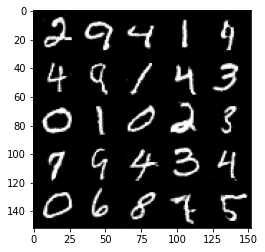

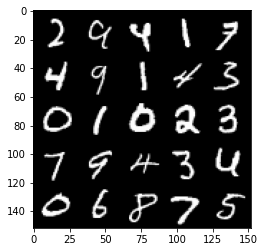

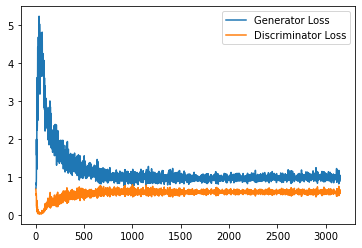

Step 63500: Generator loss: 0.9958794548511505, discriminator loss: 0.5924747376441956


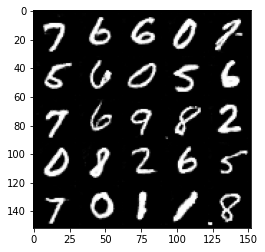

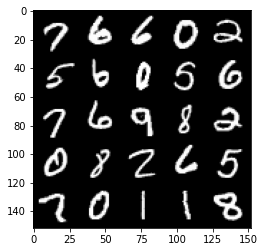

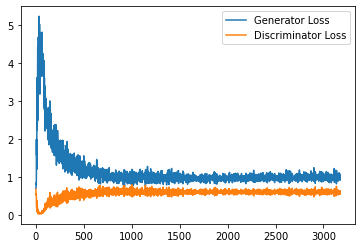

Step 64000: Generator loss: 1.0053225948810578, discriminator loss: 0.5899483421444893


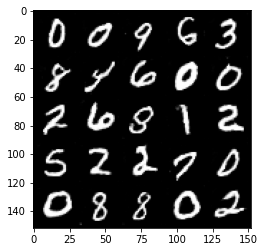

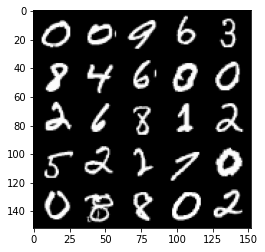

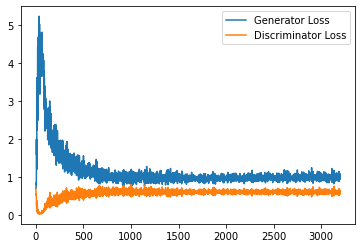

Step 64500: Generator loss: 1.0099055070877074, discriminator loss: 0.5913480358719826


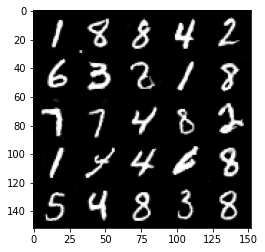

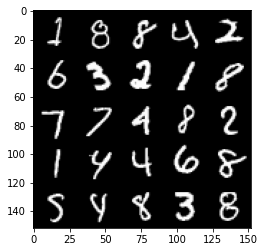

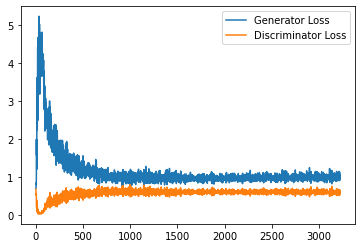

Step 65000: Generator loss: 1.0160235195159912, discriminator loss: 0.5881838881969452


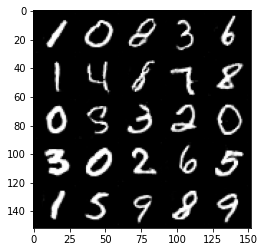

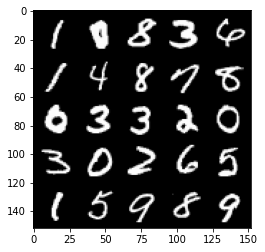

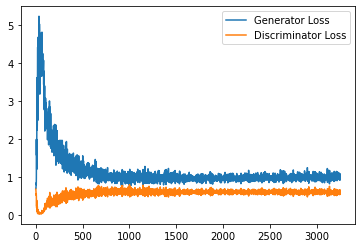

Step 65500: Generator loss: 0.9988984740972519, discriminator loss: 0.5907697842717171


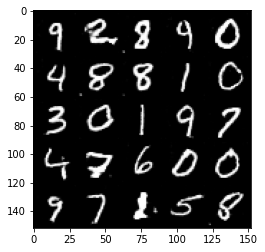

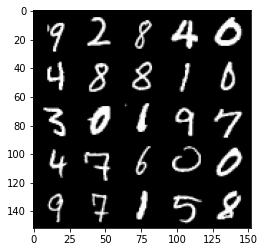

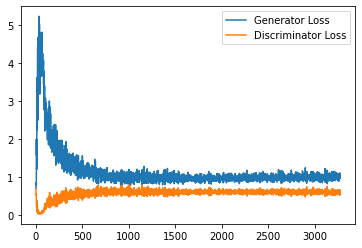

Step 66000: Generator loss: 1.011255018234253, discriminator loss: 0.5937765004634857


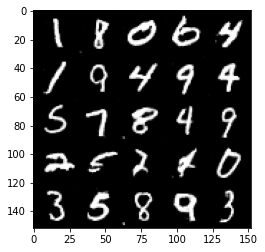

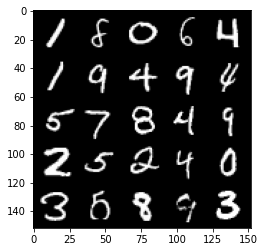

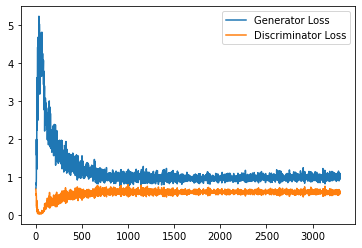

Step 66500: Generator loss: 1.0087040777206422, discriminator loss: 0.5928981760740281


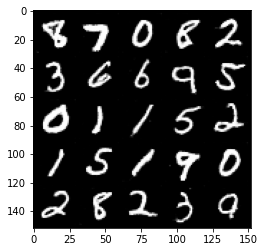

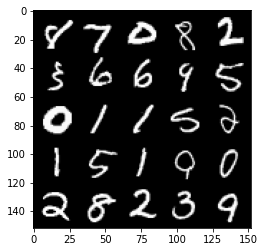

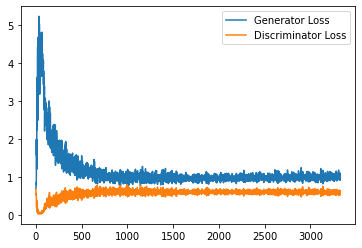

Step 67000: Generator loss: 1.0247086682319642, discriminator loss: 0.5895820840001106


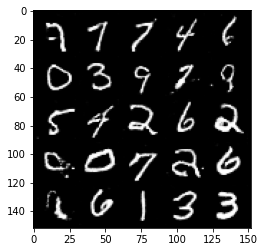

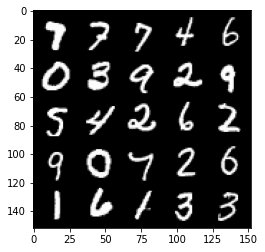

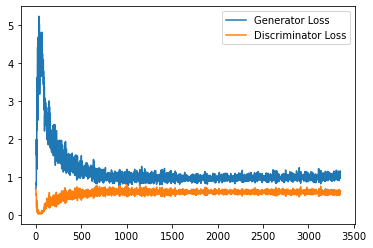

Step 67500: Generator loss: 1.0035300579071045, discriminator loss: 0.5935779584050178


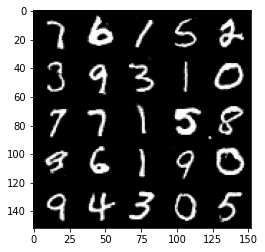

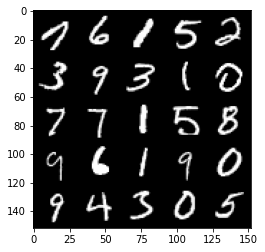

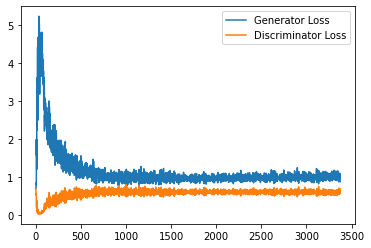

Step 68000: Generator loss: 1.0126745796203613, discriminator loss: 0.5929148933291435


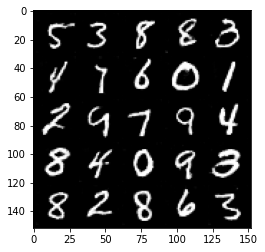

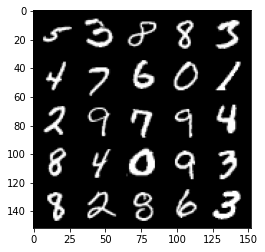

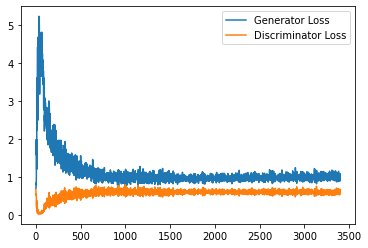

Step 68500: Generator loss: 1.015458130478859, discriminator loss: 0.5881744127273559


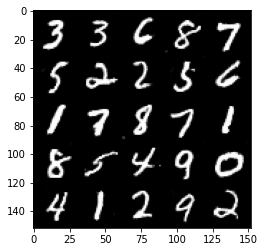

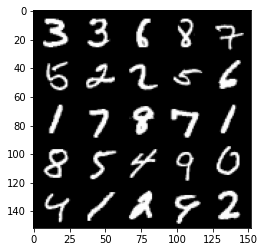

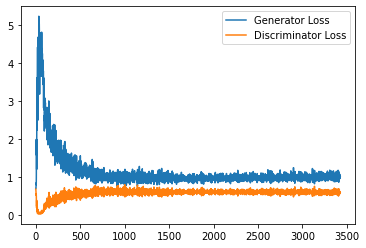

Step 69000: Generator loss: 1.003886610865593, discriminator loss: 0.5951059988737106


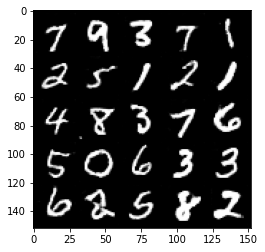

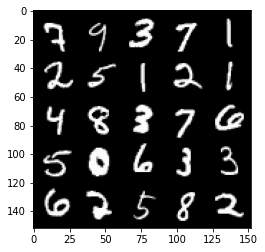

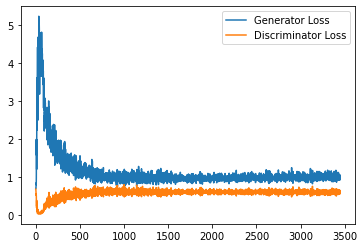

Step 69500: Generator loss: 1.0014258706569672, discriminator loss: 0.5928377436995507


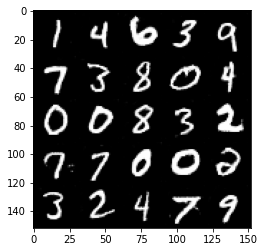

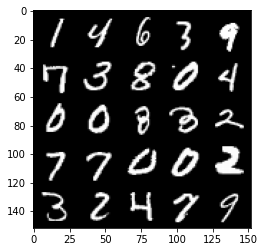

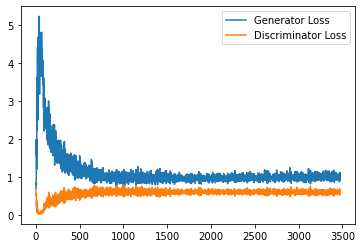

Step 70000: Generator loss: 1.0039840508699418, discriminator loss: 0.5951192358136177


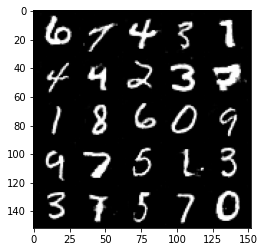

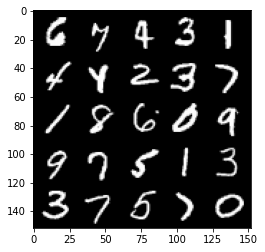

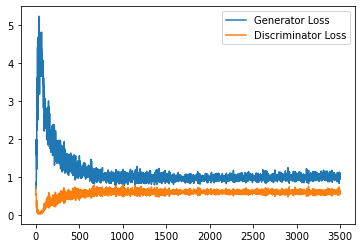

Step 70500: Generator loss: 1.0135555057525634, discriminator loss: 0.590620656311512


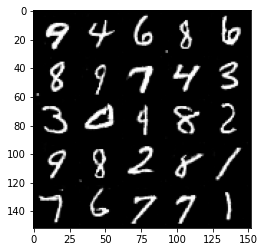

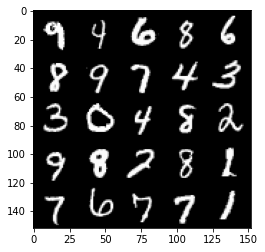

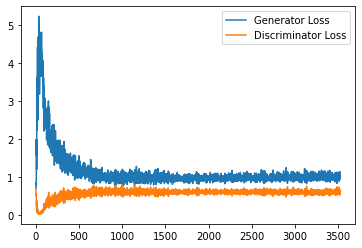

Step 71000: Generator loss: 1.0085219655036926, discriminator loss: 0.5953541734218597


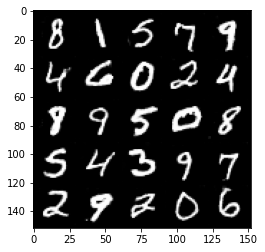

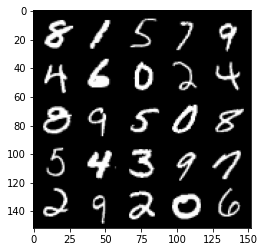

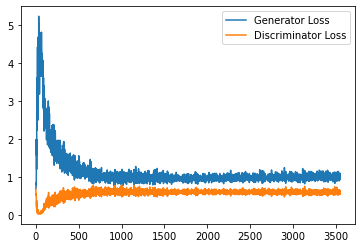

Step 71500: Generator loss: 1.0129454811811447, discriminator loss: 0.5923952607512474


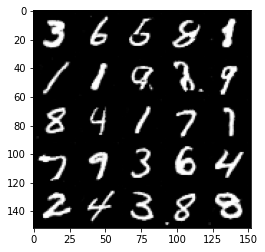

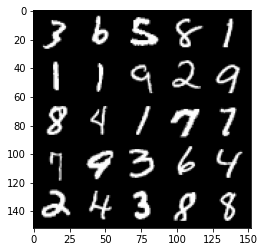

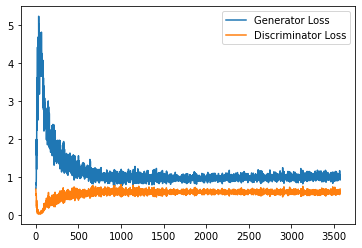

Step 72000: Generator loss: 0.9923530323505402, discriminator loss: 0.5918164839148521


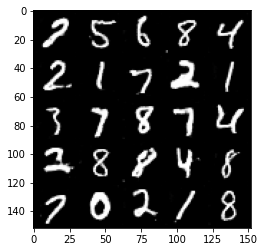

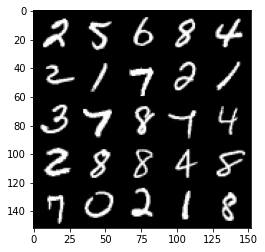

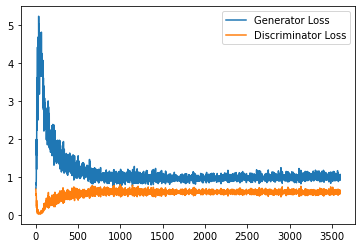

Step 72500: Generator loss: 1.0080192974805833, discriminator loss: 0.5923874639272689


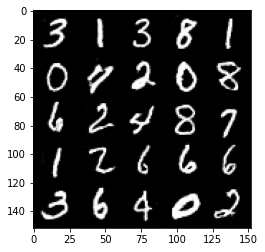

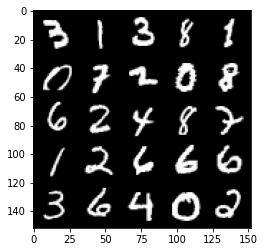

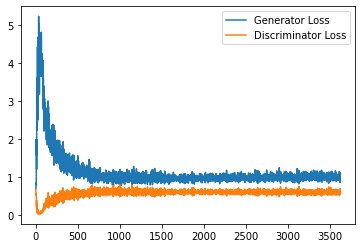

Step 73000: Generator loss: 1.0139776729345322, discriminator loss: 0.5919874672293663


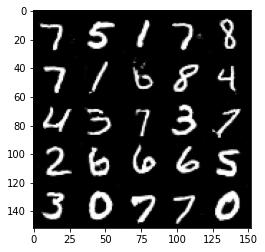

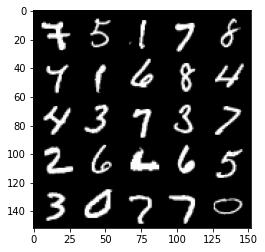

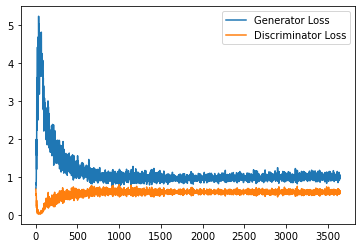

Step 73500: Generator loss: 1.0071242053508758, discriminator loss: 0.5963292846679688


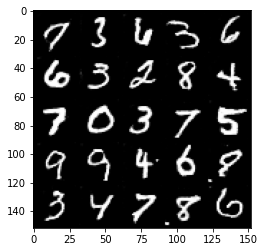

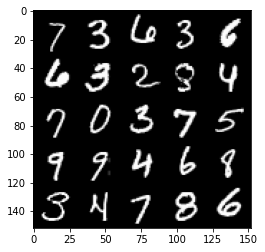

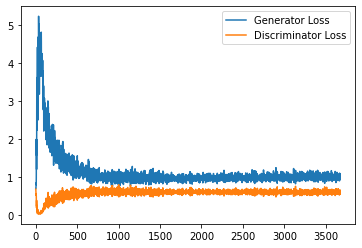

Step 74000: Generator loss: 1.0137254722118378, discriminator loss: 0.5936175214052201


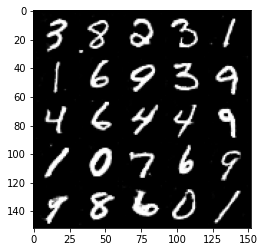

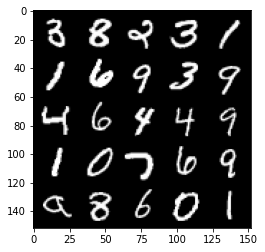

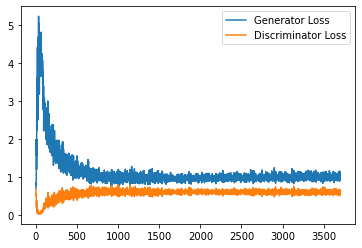

Step 74500: Generator loss: 1.0169822615385056, discriminator loss: 0.5955312756896018


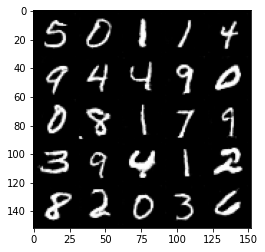

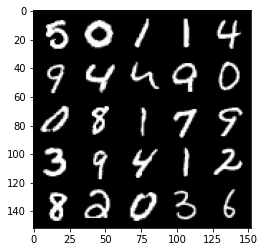

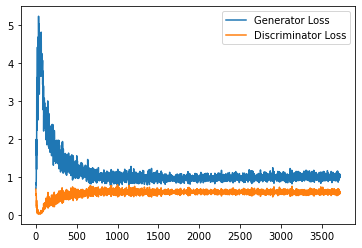

Step 75000: Generator loss: 1.00785779941082, discriminator loss: 0.5978147010803223


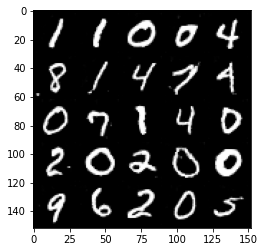

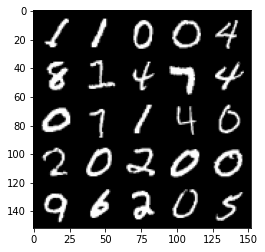

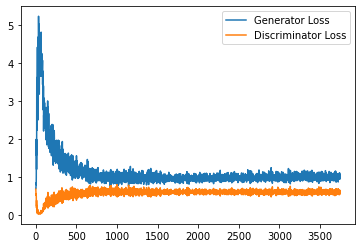

Step 75500: Generator loss: 0.994611270904541, discriminator loss: 0.5990264830589295


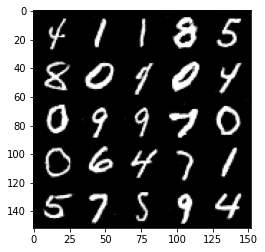

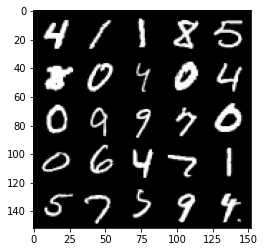

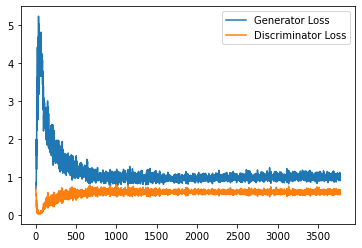

Step 76000: Generator loss: 0.9903917523622513, discriminator loss: 0.5974973313808442


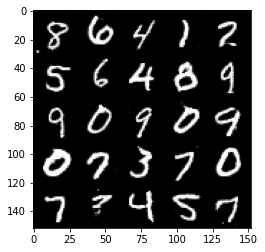

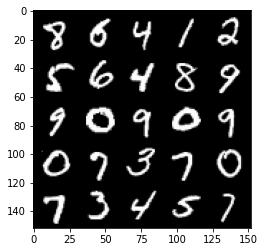

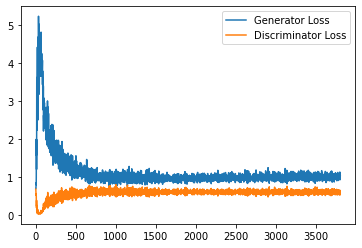

Step 76500: Generator loss: 1.0145245590209961, discriminator loss: 0.5964332963228226


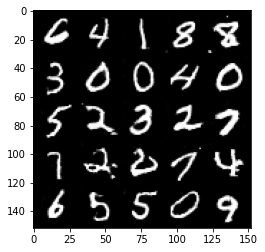

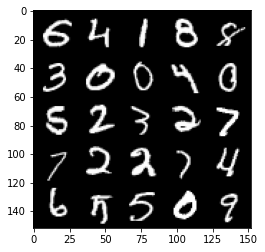

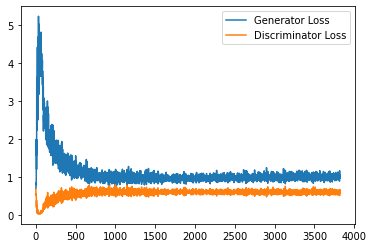

Step 77000: Generator loss: 1.0124836316108703, discriminator loss: 0.5958408077955246


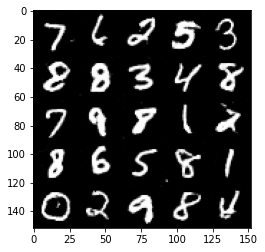

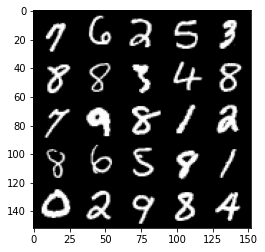

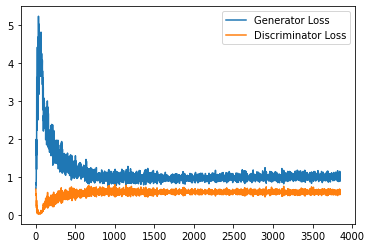

Step 77500: Generator loss: 0.9965866432189942, discriminator loss: 0.597600890994072


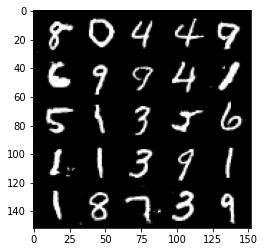

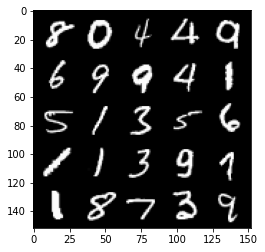

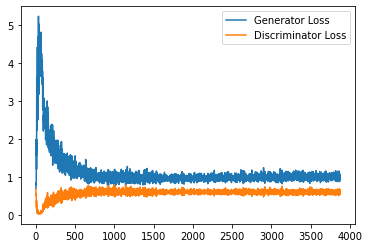

Step 78000: Generator loss: 0.994219755411148, discriminator loss: 0.6031977711319924


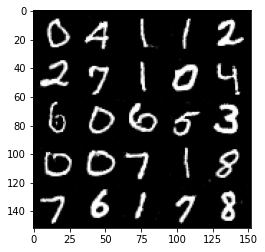

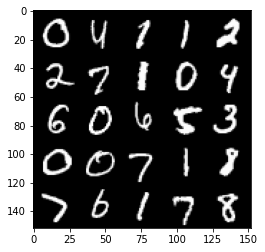

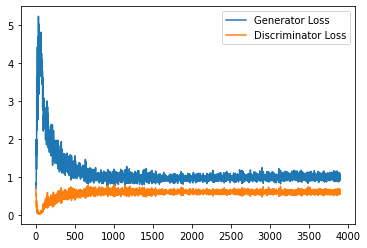

Step 78500: Generator loss: 1.0010500813722611, discriminator loss: 0.5982953979969025


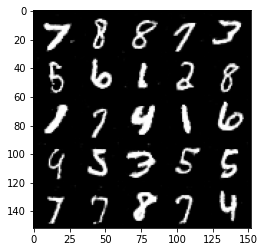

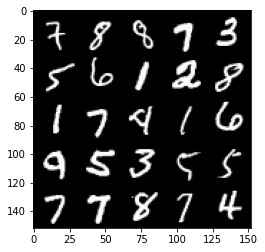

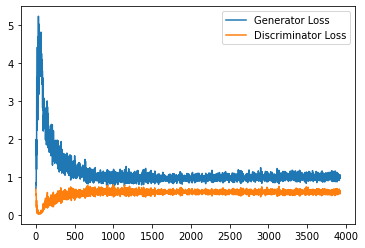

Step 79000: Generator loss: 1.0169447289705276, discriminator loss: 0.5988300979137421


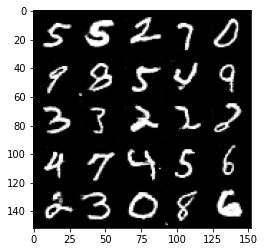

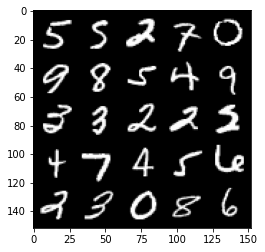

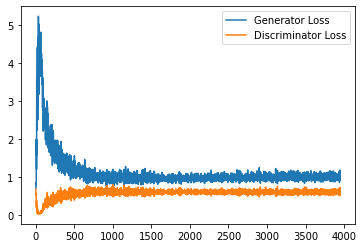

Step 79500: Generator loss: 0.9930955077409744, discriminator loss: 0.6028174148201942


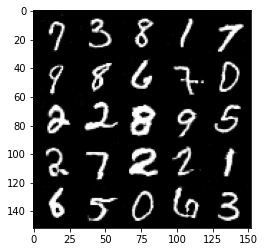

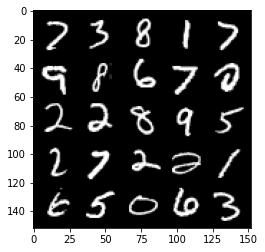

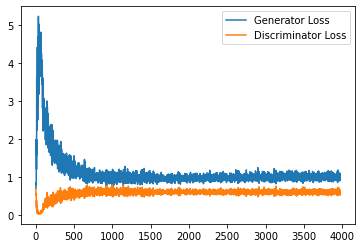

Step 80000: Generator loss: 1.0014830498695373, discriminator loss: 0.6026217436790466


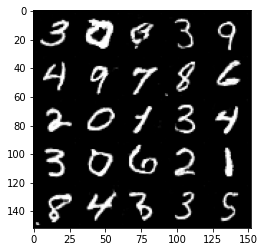

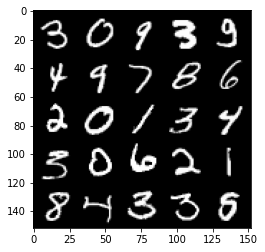

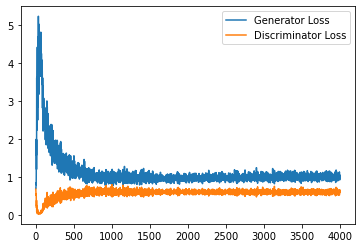

Step 80500: Generator loss: 0.984042664885521, discriminator loss: 0.6031669024825096


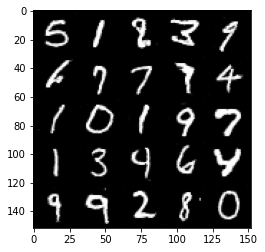

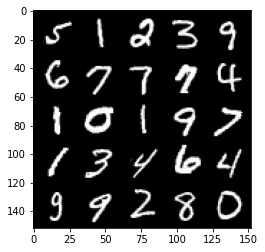

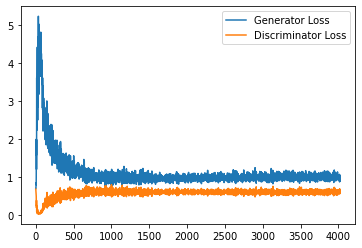

Step 81000: Generator loss: 0.9843971229791642, discriminator loss: 0.602332653939724


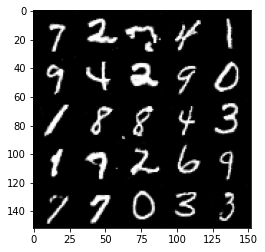

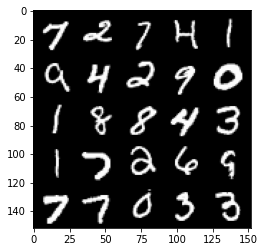

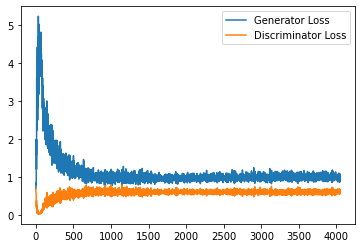

Step 81500: Generator loss: 1.0015809845924377, discriminator loss: 0.5982293349504471


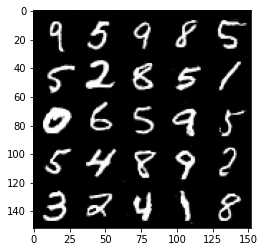

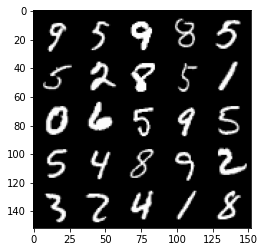

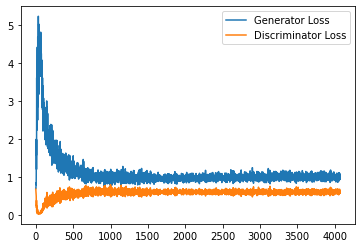

Step 82000: Generator loss: 0.9944407372474671, discriminator loss: 0.6092727957963944


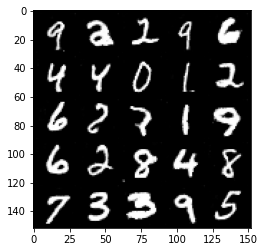

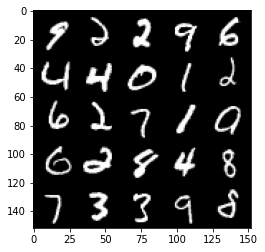

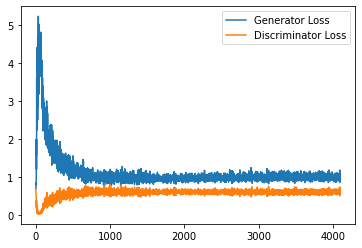

Step 82500: Generator loss: 0.9961047147512436, discriminator loss: 0.5989860095977784


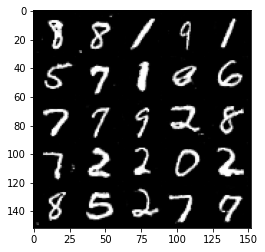

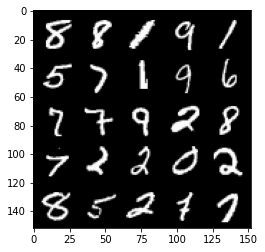

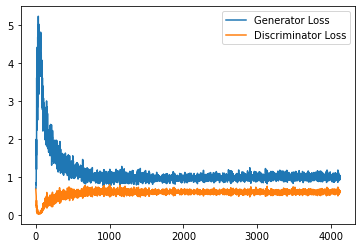

Step 83000: Generator loss: 0.9877093760967255, discriminator loss: 0.6049903163313866


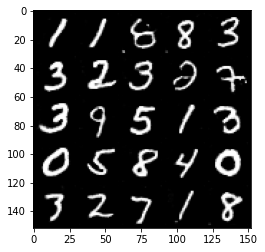

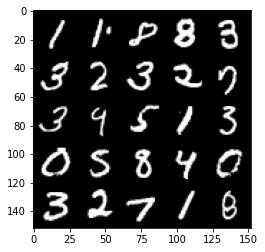

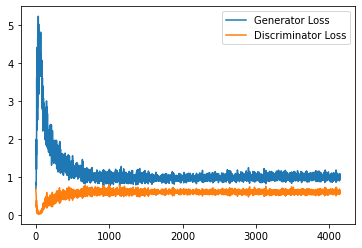

Step 83500: Generator loss: 0.9907174135446548, discriminator loss: 0.608787396967411


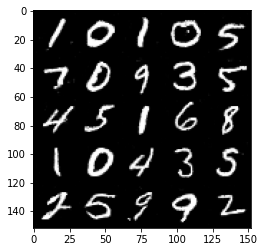

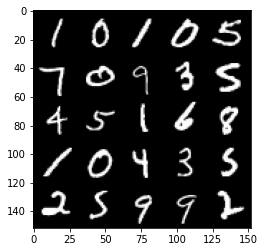

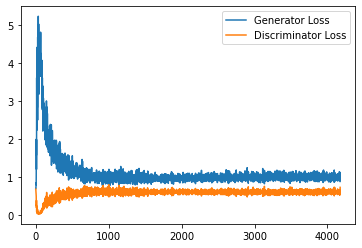

Step 84000: Generator loss: 1.0022751446962357, discriminator loss: 0.6039802030920982


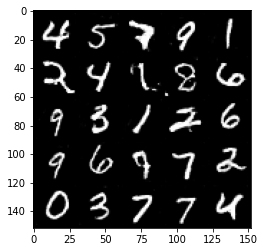

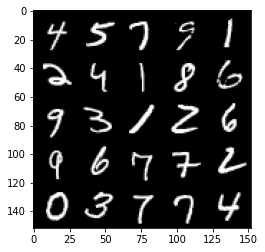

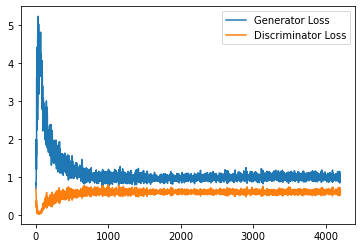

Step 84500: Generator loss: 0.9864182418584824, discriminator loss: 0.6033938962221146


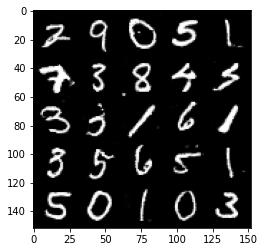

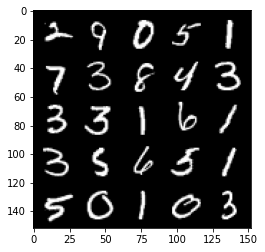

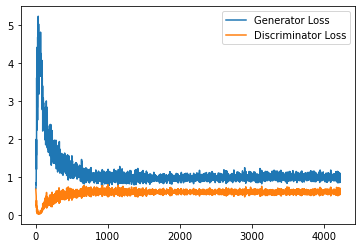

Step 85000: Generator loss: 1.0061114286184312, discriminator loss: 0.5994338769912719


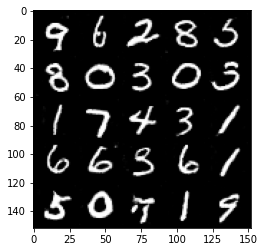

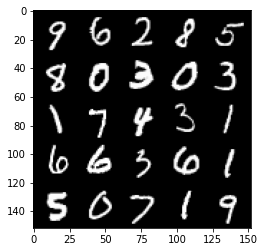

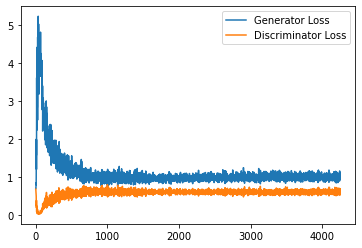

Step 85500: Generator loss: 0.9761431075334549, discriminator loss: 0.6051670623421669


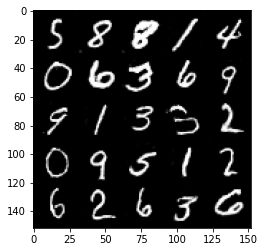

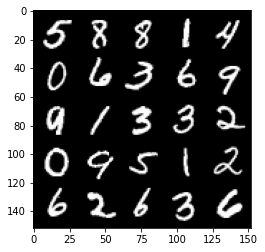

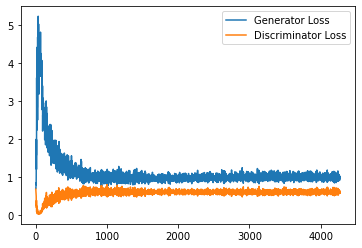

Step 86000: Generator loss: 0.9716464194059372, discriminator loss: 0.6135432891845704


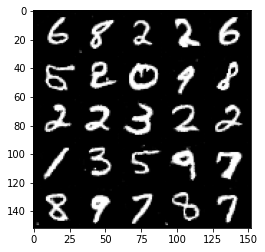

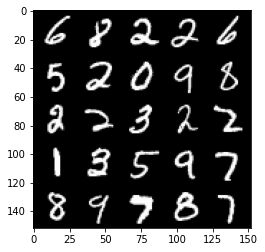

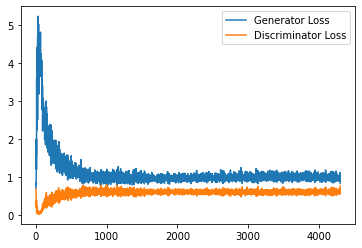

Step 86500: Generator loss: 1.0064659668207168, discriminator loss: 0.6048168948292733


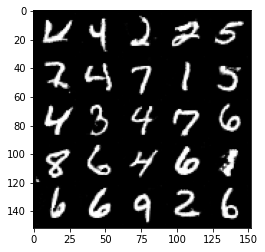

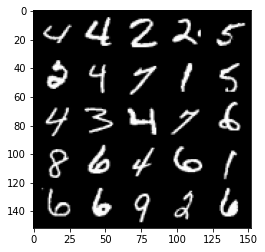

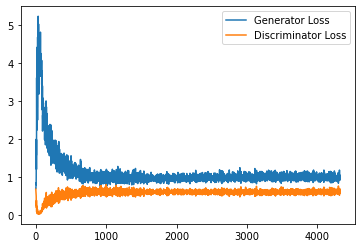

Step 87000: Generator loss: 1.0048025915622711, discriminator loss: 0.6076338374614716


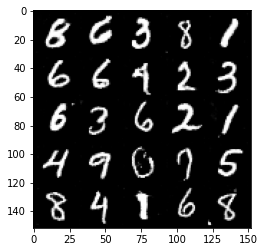

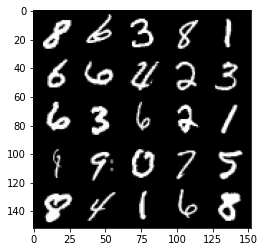

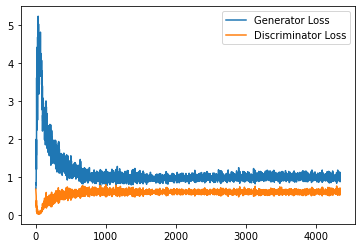

Step 87500: Generator loss: 0.9887934566736222, discriminator loss: 0.6048196075558663


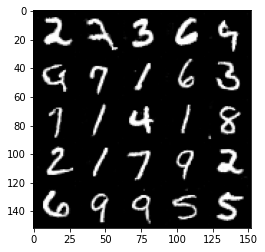

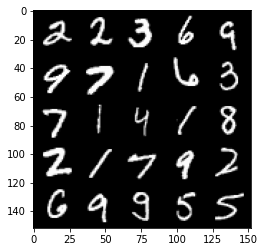

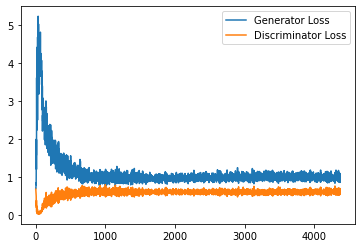

Step 88000: Generator loss: 0.9864449928998947, discriminator loss: 0.6058592293262481


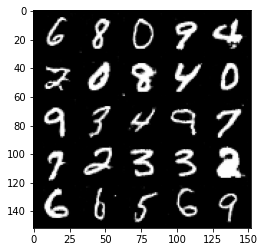

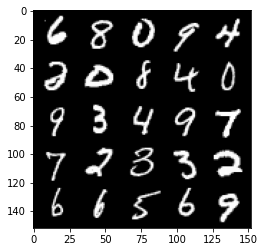

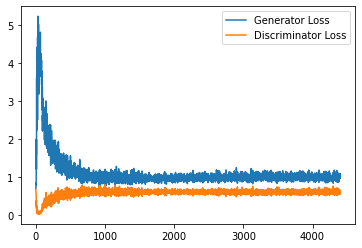

Step 88500: Generator loss: 0.9724151284694672, discriminator loss: 0.6080621981024742


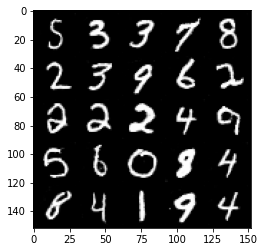

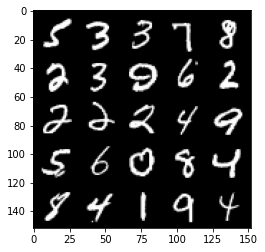

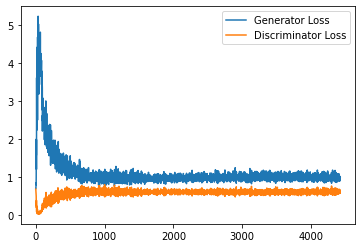

Step 89000: Generator loss: 0.9890907304286957, discriminator loss: 0.6081369470357895


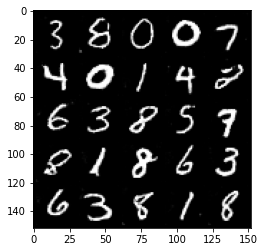

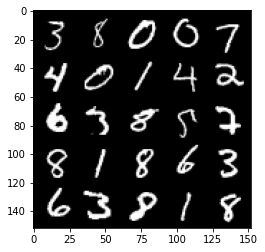

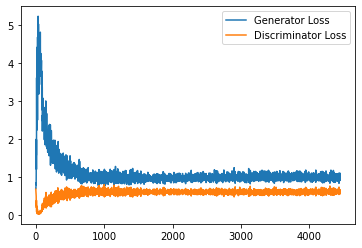

Step 89500: Generator loss: 0.979076443195343, discriminator loss: 0.6037992182374


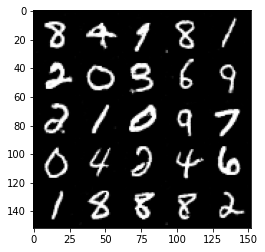

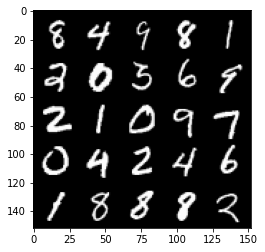

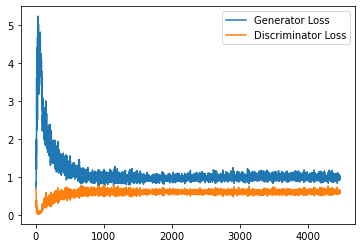

Step 90000: Generator loss: 0.9894676082134247, discriminator loss: 0.6039622896313668


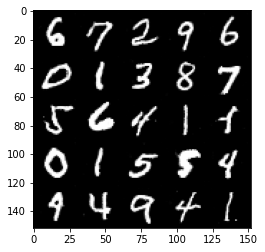

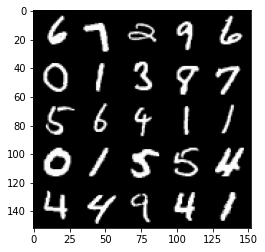

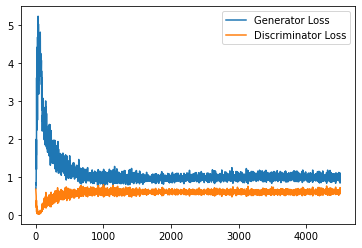

Step 90500: Generator loss: 1.0083229278326034, discriminator loss: 0.6014935179948807


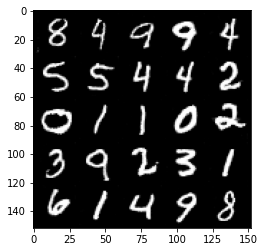

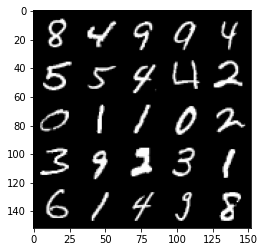

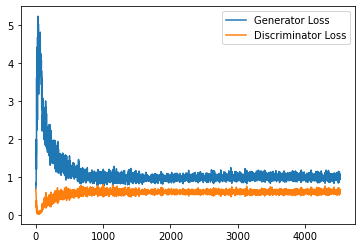

Step 91000: Generator loss: 0.9635017759799958, discriminator loss: 0.6130361687541008


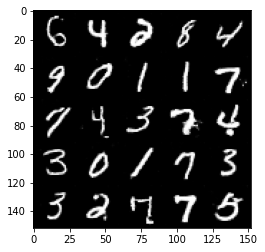

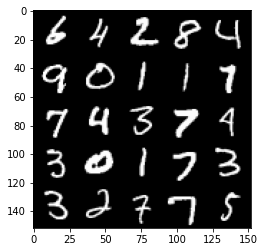

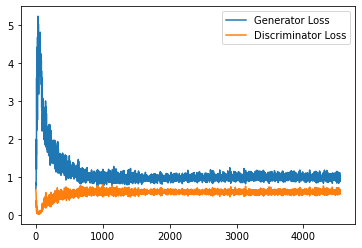

Step 91500: Generator loss: 0.9796681890487671, discriminator loss: 0.6036638073325157


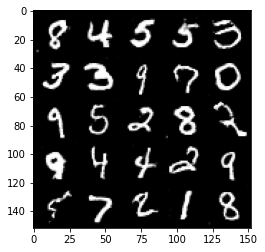

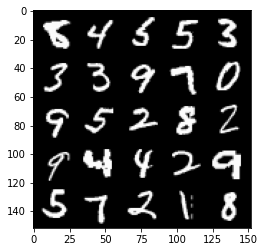

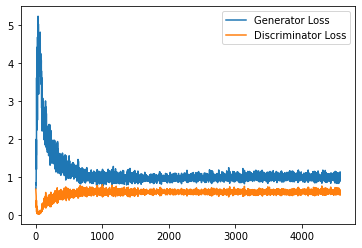

Step 92000: Generator loss: 0.9941825461387634, discriminator loss: 0.6082577084898949


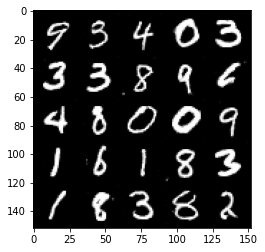

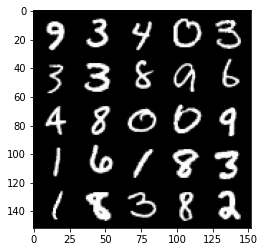

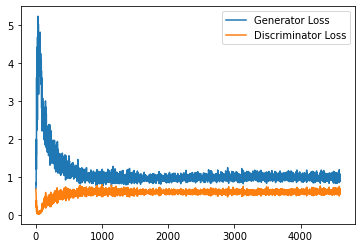

Step 92500: Generator loss: 0.993132472038269, discriminator loss: 0.609587521314621


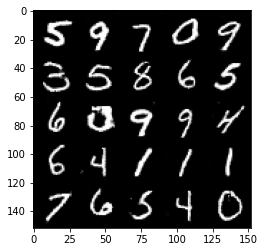

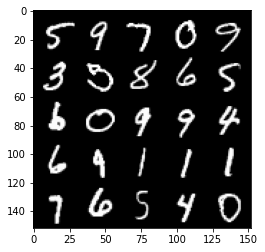

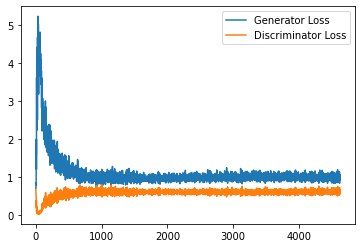

Step 93000: Generator loss: 0.9921868840456008, discriminator loss: 0.6036490652561187


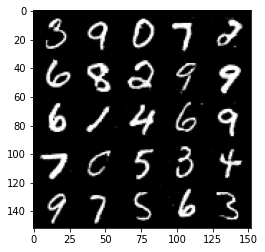

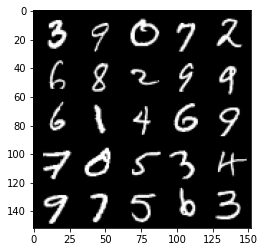

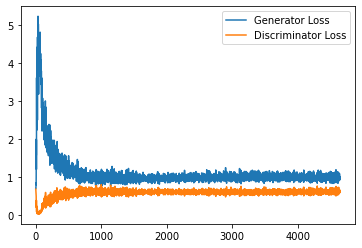

Step 93500: Generator loss: 0.9614069138765335, discriminator loss: 0.6108230416774749


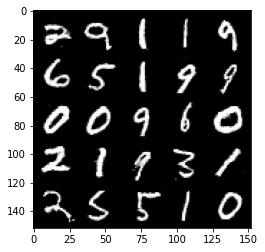

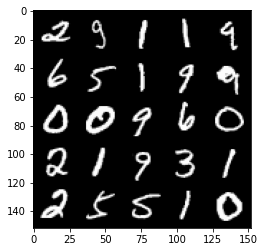

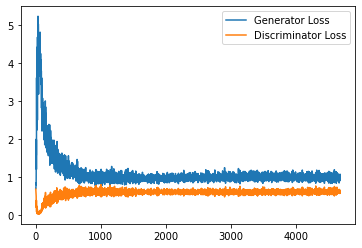

In [49]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen.forward(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc.forward(fake_image_and_labels)
        disc_real_pred = disc.forward(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [51]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

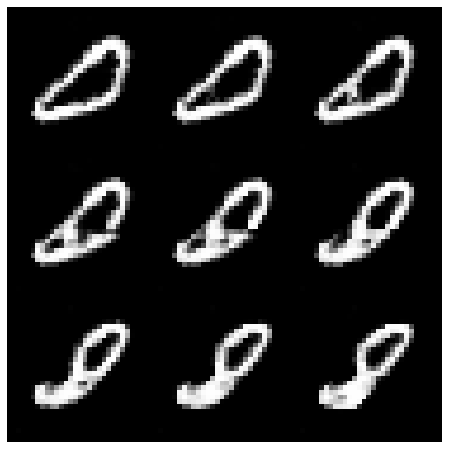

In [54]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 0 # Choose the start digit
### Change me! ###
end_plot_number = 8 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

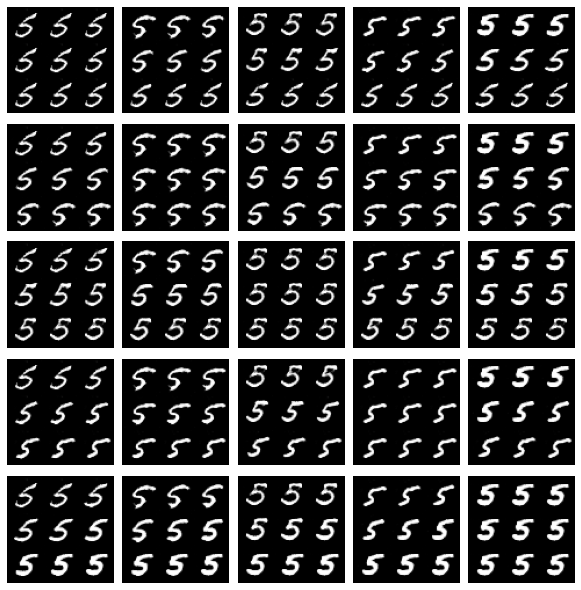

In [53]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()